In [1]:
import os
import random
import shutil

import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import sqrtm
from PIL import Image

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset, Subset
from torch.cuda.amp import GradScaler, autocast

import torchvision
from torchvision import datasets, transforms
from torchvision.models import vgg19, VGG19_Weights, inception_v3, Inception_V3_Weights
from torchvision.transforms import ToTensor, ToPILImage
from torchvision.transforms.functional import to_tensor as tensor_transform


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device is {device}")

Device is cuda


Move real world images into a single directory

In [4]:

def organize_single_class_images(directory, class_name='default_class'):
    # Check if directory exists
    if not os.path.exists(directory):
        print(f"The directory {directory} does not exist.")
        return

    # Create a subdirectory for the single class
    class_dir = os.path.join(directory, class_name)
    if not os.path.exists(class_dir):
        os.makedirs(class_dir)

    # Move all images to the new subdirectory
    for filename in os.listdir(directory):
        if filename.endswith(('.png', '.jpg', '.jpeg')):  # Modify extensions as needed
            file_path = os.path.join(directory, filename)
            new_path = os.path.join(class_dir, filename)
            shutil.move(file_path, new_path)
            print(f"Moved {file_path} to {new_path}")

# directory containing your images
image_directory = 'D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/real_world_photos/real_photos'

# Organize images into a single class subdirectory
organize_single_class_images(image_directory)


Spliting Real world Photos into Training and Testing

Data Augmentation

100
50


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


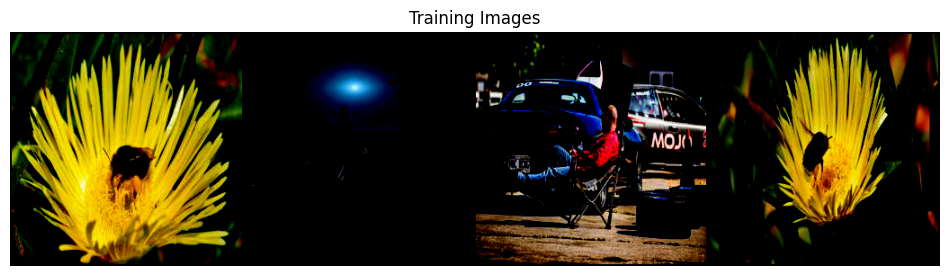

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


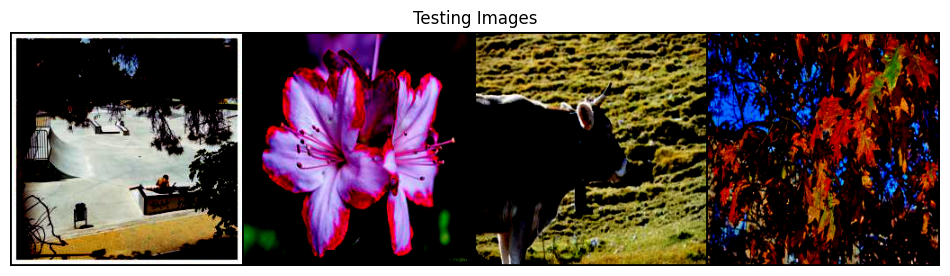

In [3]:

data_dir = 'D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/real_world_photos/real_photos'

# Define transformations for the dataset
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

# Load the full dataset
full_dataset = datasets.ImageFolder(data_dir, transform=transform)

# Determine the indices for splitting
num_images = len(full_dataset)
if num_images < 150:
    raise ValueError("The dataset does not contain enough images for the desired split.")
    
indices = list(range(num_images))
random.seed(42)  # Ensure reproducibility
random.shuffle(indices)

# Select 100 images for training and 50 images for testing
train_indices = indices[:100]
test_indices = indices[100:150]

# Create subsets
train_dataset = Subset(full_dataset, train_indices)
test_dataset = Subset(full_dataset, test_indices)

# Create DataLoaders
real_train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True)
real_test_dataloader = DataLoader(test_dataset, batch_size=4, shuffle=True)

print(len(train_dataset))
print(len(test_dataset))

# Function to display images
def display_images(dataloader, title):
    batch = next(iter(dataloader))
    images, labels = batch
    plt.figure(figsize=(12, 8))
    grid_img = torchvision.utils.make_grid(images, nrow=4)
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Display images from the training and testing DataLoaders
display_images(real_train_dataloader, 'Training Images')
display_images(real_test_dataloader, 'Testing Images')


### Cartoon Images

- Due to Compute resources a Subset of the Cartoon Images was used for training the model

Edge Detection

In [4]:
def process_cartoon_image(cartoon_image):
    # Convert to numpy array and grayscale
    cartoon_np = cartoon_image.permute(1, 2, 0).cpu().numpy()
    cartoon_np = (cartoon_np * 255).astype(np.uint8)
    gray = cv2.cvtColor(cartoon_np, cv2.COLOR_RGB2GRAY)
    
    # Detect edges
    edges = cv2.Canny(gray, threshold1=100, threshold2=200)
    
    # Dilate edges
    dilated_edges = cv2.dilate(edges, None)
    
    # Apply Gaussian smoothing
    smoothed = cv2.GaussianBlur(cartoon_np, (5, 5), 0)
    
    # Mask out edges
    mask = dilated_edges > 0
    smoothed[mask] = cartoon_np[mask]
    
    # Convert back to tensor
    smoothed_tensor = tensor_transform(smoothed / 255.0).float()
    return smoothed_tensor.cuda()


Data Loading and Data Augmentation

In [5]:
# Define transformations for the dataset
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

# Load the datasets
edged_smoothed_shinkai_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images_edge_smoothed/Makoto Shinkai Processed', transform=transform)
edged_smoothed_hosoda_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images_edge_smoothed/Mamoru Hosoda Processed', transform=transform)
edged_smoothed_miyazaki_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images_edge_smoothed/Miyazaki Hayao Processed', transform=transform)
edged_smoothed_kon_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images_edge_smoothed/Paprika Processed', transform=transform)

shinkai_dataset = datasets.ImageFolder('D:\Wits First Semester Courses\DIP\DIP Project\CartoonGan_data\cartoon_images\Makoto Shinkai', transform=transform)
hosoda_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images/Mamoru Hosoda', transform=transform)
miyazaki_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images/Miyazaki Hayao', transform=transform)
kon_dataset = datasets.ImageFolder('D:/Wits First Semester Courses/DIP/DIP Project/CartoonGan_data/cartoon_images/Paprika', transform=transform)

# Create DataLoaders
edged_smoothed_shinkai_dataloader = DataLoader(edged_smoothed_shinkai_dataset, batch_size=4, shuffle=True)
edged_smoothed_hosoda_dataloader = DataLoader(edged_smoothed_hosoda_dataset, batch_size=4, shuffle=True)
edged_smoothed_miyazaki_dataloader = DataLoader(edged_smoothed_miyazaki_dataset, batch_size=4, shuffle=True)
edged_smoothed_kon_dataloader = DataLoader(edged_smoothed_kon_dataset, batch_size=4, shuffle=True)

shinkai_dataloader = DataLoader(shinkai_dataset, batch_size=4, shuffle=True)
hosoda_dataloader = DataLoader(hosoda_dataset, batch_size=4, shuffle=True)
miyazaki_dataloader = DataLoader(miyazaki_dataset, batch_size=4, shuffle=True)
kon_dataloader = DataLoader(kon_dataset, batch_size=4, shuffle=True)


# Function to display images
def display_images(dataloader, title):
    batch = next(iter(dataloader))
    images, labels = batch
    plt.figure(figsize=(12, 8))
    grid_img = torchvision.utils.make_grid(images, nrow=4)
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Display images from each dataloader
#display_images(shinkai_dataloader, 'Shinkai Images')
#display_images(hosoda_dataloader, 'Hosoda Images')
#display_images(miyazaki_dataloader, 'Miyazaki Images')
#display_images(kon_dataloader, 'Kon Images')
#display_images(edged_smoothed_shinkai_dataloader, 'Edge Smoothed Shinkai Images')
#display_images(edged_smoothed_hosoda_dataloader, 'Edge Smoothed Hosoda Images')
#display_images(edged_smoothed_miyazaki_dataloader, 'Edge Smoothed Miyazaki Images')
#display_images(edged_smoothed_kon_dataloader, 'Edge Smoothed Kon Images')



In [7]:
# Check the sizes of the datasets
print(f'Shinkai set size: {len(shinkai_dataset)}')
print(f'hosoda set size: {len(hosoda_dataset)}')
print(f'miyazaki set size: {len(miyazaki_dataset)}')
print(f'kon set size: {len(kon_dataset)}')

# Check the sizes of the datasets
print(f'Shinkai set size: {len(edged_smoothed_shinkai_dataset)}')
print(f'hosoda set size: {len(edged_smoothed_hosoda_dataset)}')
print(f'miyazaki set size: {len(edged_smoothed_miyazaki_dataset)}')
print(f'kon set size: {len(edged_smoothed_kon_dataset)}')

Shinkai set size: 7285
hosoda set size: 7021
miyazaki set size: 7472
kon set size: 5432
Shinkai set size: 7285
hosoda set size: 7021
miyazaki set size: 7472
kon set size: 5432


Creating a Subset of the Data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


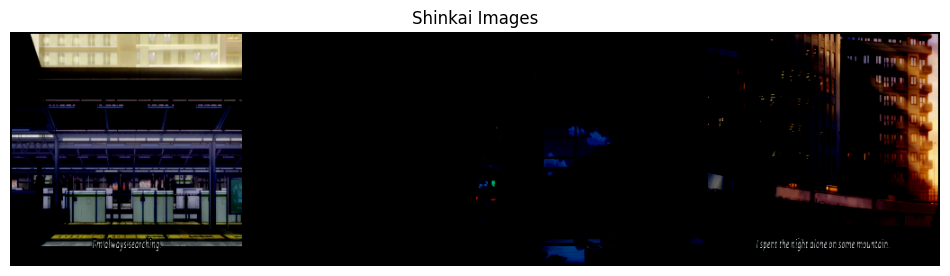

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9607843..1.0].


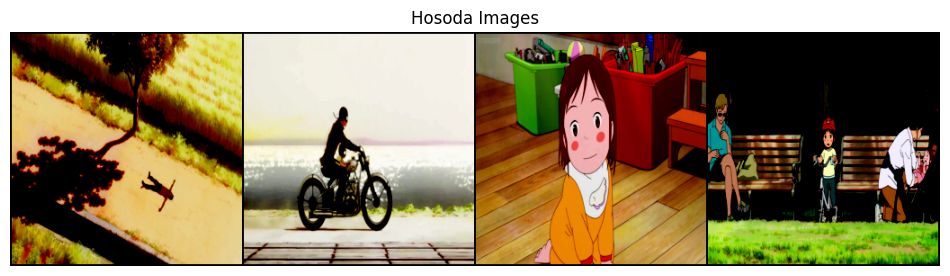

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.96862745..1.0].


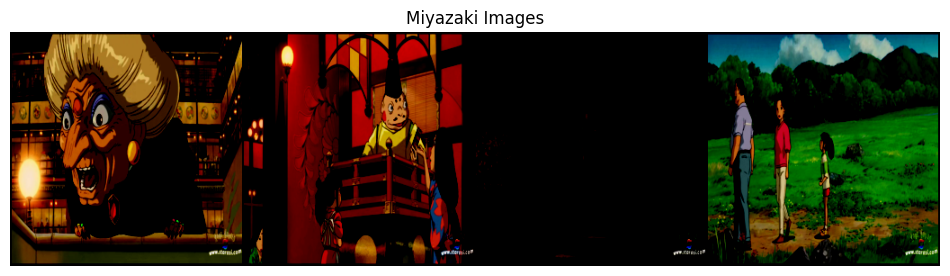

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9529412].


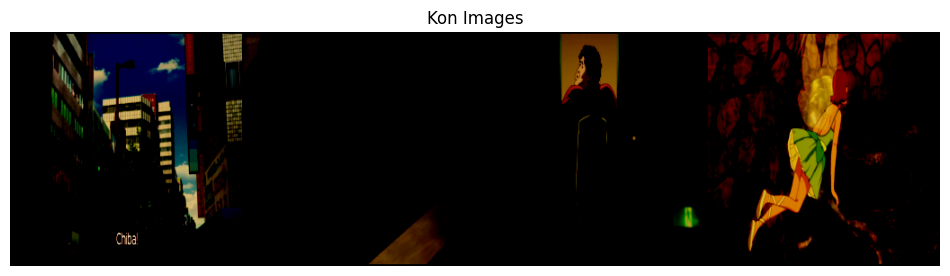

In [20]:
import random
# Define the number of images to use
num_images_to_use = 600

# Function to create a subset of the dataset
def create_subset(dataset, num_images):
    indices = list(range(len(dataset)))
    random.shuffle(indices)
    subset_indices = indices[:num_images]
    subset = Subset(dataset, subset_indices)
    return subset

# Create subsets
shinkai_subset = create_subset(shinkai_dataset, num_images_to_use)
hosoda_subset = create_subset(hosoda_dataset, num_images_to_use)
miyazaki_subset = create_subset(miyazaki_dataset, num_images_to_use)
kon_subset = create_subset(kon_dataset, num_images_to_use)

# Create subsets
edged_smoothed_shinkai_subset = create_subset(edged_smoothed_shinkai_dataset, num_images_to_use)
edged_smoothed_hosoda_subset = create_subset(edged_smoothed_hosoda_dataset, num_images_to_use)
edged_smoothed_miyazaki_subset = create_subset(edged_smoothed_miyazaki_dataset, num_images_to_use)
edged_smoothed_kon_subset = create_subset(edged_smoothed_kon_dataset, num_images_to_use)

# Create DataLoaders for the subsets
shinkai_dataloader = DataLoader(shinkai_subset, batch_size=4, shuffle=True)
hosoda_dataloader = DataLoader(hosoda_subset, batch_size=4, shuffle=True)
miyazaki_dataloader = DataLoader(miyazaki_subset, batch_size=4, shuffle=True)
kon_dataloader = DataLoader(kon_subset, batch_size=4, shuffle=True)

edged_smoothed_shinkai_dataloader = DataLoader(edged_smoothed_shinkai_subset, batch_size=4, shuffle=True)
edged_smoothed_hosoda_dataloader = DataLoader(edged_smoothed_hosoda_subset, batch_size=4, shuffle=True)
edged_smoothed_miyazaki_dataloader = DataLoader(edged_smoothed_miyazaki_subset, batch_size=4, shuffle=True)
edged_smoothed_kon_dataloader = DataLoader(edged_smoothed_kon_subset, batch_size=4, shuffle=True)

# Function to display images
def display_images(dataloader, title):
    batch = next(iter(dataloader))
    images, labels = batch
    plt.figure(figsize=(12, 8))
    grid_img = torchvision.utils.make_grid(images, nrow=4)
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.title(title)
    plt.axis('off')
    plt.show()

# Display images from each dataloader
display_images(shinkai_dataloader, 'Shinkai Images')
display_images(hosoda_dataloader, 'Hosoda Images')
display_images(miyazaki_dataloader, 'Miyazaki Images')
display_images(kon_dataloader, 'Kon Images')

In [21]:
# Check the sizes of the datasets
print(f'Shinkai set size: {len(shinkai_subset)}')
print(f'hosoda set size: {len(hosoda_subset)}')
print(f'miyazaki set size: {len(miyazaki_subset)}')
print(f'kon set size: {len(kon_subset)}')

print(f'Shinkai set size: {len(edged_smoothed_shinkai_subset)}')
print(f'hosoda set size: {len(edged_smoothed_hosoda_subset)}')
print(f'miyazaki set size: {len(edged_smoothed_miyazaki_subset)}')
print(f'kon set size: {len(edged_smoothed_kon_subset)}')

Shinkai set size: 600
hosoda set size: 600
miyazaki set size: 600
kon set size: 600
Shinkai set size: 600
hosoda set size: 600
miyazaki set size: 600
kon set size: 600


In [22]:

# Example of loading a batch of real-world images
for imgs, _ in shinkai_dataloader:
    # imgs is a batch of real-world images
    print(imgs.shape)  # Expected output: torch.Size([32, 3, 256, 256])
    print(len(imgs))
    break

# Example of loading a batch of cartoon images
for imgs, _ in hosoda_dataloader:
    # imgs is a batch of cartoon images
    print(imgs.shape)  # Expected output: torch.Size([32, 3, 256, 256])
    print(len(imgs))
    break

# Example of loading a batch of cartoon images
for imgs, _ in miyazaki_dataloader:
    # imgs is a batch of cartoon images
    print(imgs.shape)  # Expected output: torch.Size([32, 3, 256, 256])
    print(len(imgs))
    break

# Example of loading a batch of cartoon images
for imgs, _ in kon_dataloader:
    # imgs is a batch of cartoon images
    print(imgs.shape)  # Expected output: torch.Size([32, 3, 256, 256])
    print(len(imgs))
    break

torch.Size([4, 3, 256, 256])
4
torch.Size([4, 3, 256, 256])
4
torch.Size([4, 3, 256, 256])
4
torch.Size([4, 3, 256, 256])
4


Generator

In [83]:
# Utility functions for initializing weights and models
def init_weights(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
        nn.init.normal_(m.weight, 0.0, 0.02)


class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(in_channels)
        )

    def forward(self, x):
        return x + self.block(x)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.initial = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=7, stride=1, padding=3),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )

        self.downsampling = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )

        self.residuals = nn.Sequential(
            *[ResidualBlock(256) for _ in range(8)]
        )

        self.upsampling = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )

        self.final = nn.Sequential(
            nn.Conv2d(64, 3, kernel_size=7, stride=1, padding=3),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.initial(x)
        x = self.downsampling(x)
        x = self.residuals(x)
        x = self.upsampling(x)
        x = self.final(x)
        return x


Discriminator

In [11]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, kernel_size=3, stride=1, padding=1)
            
        )
        self.fc = nn.Linear(1024, 1)
    def forward(self, x):
        x = self.model(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x


Adversarial loss

In [91]:
def adversarial_loss(output, labels):
    return nn.BCEWithLogitsLoss()(output, labels)

adversarial_loss = nn.BCEWithLogitsLoss().cuda()

Content Loss

In [12]:
class VGGFeatureExtractor(nn.Module):
    def __init__(self):
        super(VGGFeatureExtractor, self).__init__()
        weights = VGG19_Weights.IMAGENET1K_V1
        vgg = vgg19(weights=weights)
        self.features = nn.Sequential(*list(vgg.features)[:21]).eval()
        
        for param in self.features.parameters():
            param.requires_grad = False

    def forward(self, x):
        return self.features(x)


def content_loss(fake_features, real_features, vgg):
    gen_features = vgg(fake_features)
    orig_features = vgg(real_features)
    return nn.L1Loss()(gen_features, orig_features)


Function for Saving the Model

In [14]:
# Define function to save model checkpoints
def save_checkpoint(state, filename="checkpoint.pth.tar"):
    torch.save(state, filename)

Initialisation phase
- Initialise generator with content loss only

[Initialization Epoch 0/30] [Batch 0/25] [Content Loss: 1.2006709575653076]
[Initialization Epoch 0/30] [Batch 1/25] [Content Loss: 1.5166130065917969]
[Initialization Epoch 0/30] [Batch 2/25] [Content Loss: 1.4870516061782837]
[Initialization Epoch 0/30] [Batch 3/25] [Content Loss: 1.3569419384002686]
[Initialization Epoch 0/30] [Batch 4/25] [Content Loss: 1.3512951135635376]
[Initialization Epoch 0/30] [Batch 5/25] [Content Loss: 1.3573131561279297]
[Initialization Epoch 0/30] [Batch 6/25] [Content Loss: 1.3458952903747559]
[Initialization Epoch 0/30] [Batch 7/25] [Content Loss: 1.3442423343658447]
[Initialization Epoch 0/30] [Batch 8/25] [Content Loss: 1.2199257612228394]
[Initialization Epoch 0/30] [Batch 9/25] [Content Loss: 1.2312556505203247]
[Initialization Epoch 0/30] [Batch 10/25] [Content Loss: 1.1170127391815186]
[Initialization Epoch 0/30] [Batch 11/25] [Content Loss: 1.0442450046539307]
[Initialization Epoch 0/30] [Batch 12/25] [Content Loss: 1.0706760883331299]
[Initiali

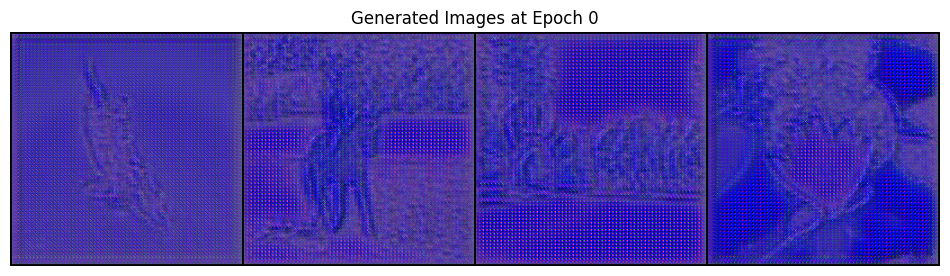

[Initialization Epoch 1/30] [Batch 0/25] [Content Loss: 0.9884293079376221]
[Initialization Epoch 1/30] [Batch 1/25] [Content Loss: 1.018217921257019]
[Initialization Epoch 1/30] [Batch 2/25] [Content Loss: 0.9225072860717773]
[Initialization Epoch 1/30] [Batch 3/25] [Content Loss: 0.9136160612106323]
[Initialization Epoch 1/30] [Batch 4/25] [Content Loss: 0.8428357839584351]
[Initialization Epoch 1/30] [Batch 5/25] [Content Loss: 1.0561470985412598]
[Initialization Epoch 1/30] [Batch 6/25] [Content Loss: 1.014322280883789]
[Initialization Epoch 1/30] [Batch 7/25] [Content Loss: 0.9910821914672852]
[Initialization Epoch 1/30] [Batch 8/25] [Content Loss: 0.8464430570602417]
[Initialization Epoch 1/30] [Batch 9/25] [Content Loss: 0.8918619155883789]
[Initialization Epoch 1/30] [Batch 10/25] [Content Loss: 0.985931396484375]
[Initialization Epoch 1/30] [Batch 11/25] [Content Loss: 0.9729163646697998]
[Initialization Epoch 1/30] [Batch 12/25] [Content Loss: 0.8689844608306885]
[Initializat

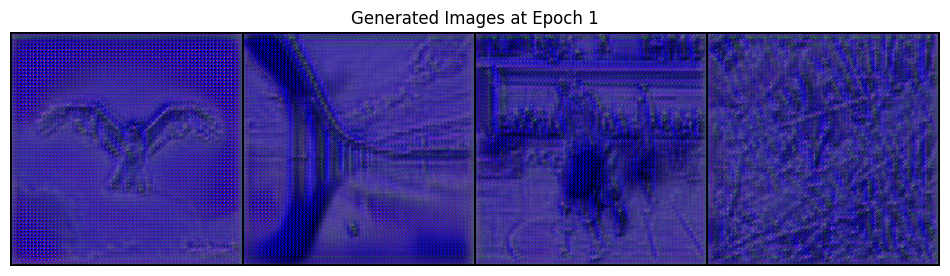

[Initialization Epoch 2/30] [Batch 0/25] [Content Loss: 0.8280062675476074]
[Initialization Epoch 2/30] [Batch 1/25] [Content Loss: 1.0318995714187622]
[Initialization Epoch 2/30] [Batch 2/25] [Content Loss: 1.1078717708587646]
[Initialization Epoch 2/30] [Batch 3/25] [Content Loss: 0.9521393775939941]
[Initialization Epoch 2/30] [Batch 4/25] [Content Loss: 1.0051753520965576]
[Initialization Epoch 2/30] [Batch 5/25] [Content Loss: 0.9024674892425537]
[Initialization Epoch 2/30] [Batch 6/25] [Content Loss: 1.2281397581100464]
[Initialization Epoch 2/30] [Batch 7/25] [Content Loss: 0.759225606918335]
[Initialization Epoch 2/30] [Batch 8/25] [Content Loss: 0.8941318988800049]
[Initialization Epoch 2/30] [Batch 9/25] [Content Loss: 1.0035109519958496]
[Initialization Epoch 2/30] [Batch 10/25] [Content Loss: 0.8484488129615784]
[Initialization Epoch 2/30] [Batch 11/25] [Content Loss: 0.8713389039039612]
[Initialization Epoch 2/30] [Batch 12/25] [Content Loss: 0.85612553358078]
[Initializat

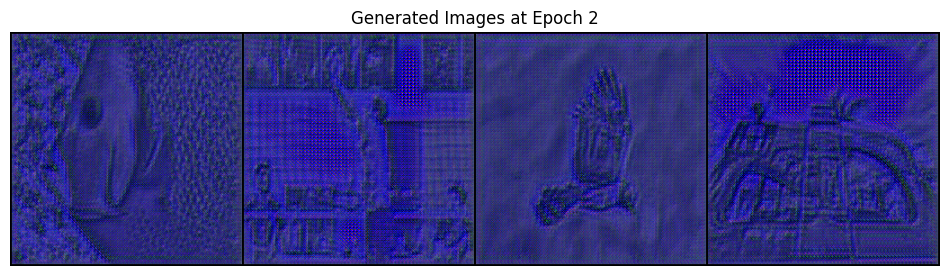

[Initialization Epoch 3/30] [Batch 0/25] [Content Loss: 0.7630664110183716]
[Initialization Epoch 3/30] [Batch 1/25] [Content Loss: 0.686581552028656]
[Initialization Epoch 3/30] [Batch 2/25] [Content Loss: 0.935400128364563]
[Initialization Epoch 3/30] [Batch 3/25] [Content Loss: 0.7790698409080505]
[Initialization Epoch 3/30] [Batch 4/25] [Content Loss: 0.9375050067901611]
[Initialization Epoch 3/30] [Batch 5/25] [Content Loss: 0.8354916572570801]
[Initialization Epoch 3/30] [Batch 6/25] [Content Loss: 1.0857850313186646]
[Initialization Epoch 3/30] [Batch 7/25] [Content Loss: 0.7997262477874756]
[Initialization Epoch 3/30] [Batch 8/25] [Content Loss: 0.6976433992385864]
[Initialization Epoch 3/30] [Batch 9/25] [Content Loss: 0.8998146653175354]
[Initialization Epoch 3/30] [Batch 10/25] [Content Loss: 0.6515238285064697]
[Initialization Epoch 3/30] [Batch 11/25] [Content Loss: 0.9514732360839844]
[Initialization Epoch 3/30] [Batch 12/25] [Content Loss: 0.8923900127410889]
[Initializa

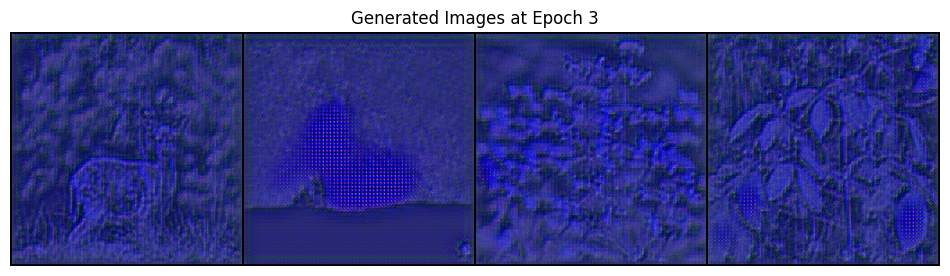

[Initialization Epoch 4/30] [Batch 0/25] [Content Loss: 0.8809105753898621]
[Initialization Epoch 4/30] [Batch 1/25] [Content Loss: 0.7963229417800903]
[Initialization Epoch 4/30] [Batch 2/25] [Content Loss: 0.8272385001182556]
[Initialization Epoch 4/30] [Batch 3/25] [Content Loss: 0.9805907011032104]
[Initialization Epoch 4/30] [Batch 4/25] [Content Loss: 0.7730587720870972]
[Initialization Epoch 4/30] [Batch 5/25] [Content Loss: 0.9136478900909424]
[Initialization Epoch 4/30] [Batch 6/25] [Content Loss: 0.7980816960334778]
[Initialization Epoch 4/30] [Batch 7/25] [Content Loss: 1.0091145038604736]
[Initialization Epoch 4/30] [Batch 8/25] [Content Loss: 0.8743636608123779]
[Initialization Epoch 4/30] [Batch 9/25] [Content Loss: 0.7663854360580444]
[Initialization Epoch 4/30] [Batch 10/25] [Content Loss: 0.7339786887168884]
[Initialization Epoch 4/30] [Batch 11/25] [Content Loss: 0.7444945573806763]
[Initialization Epoch 4/30] [Batch 12/25] [Content Loss: 0.8011890053749084]
[Initiali

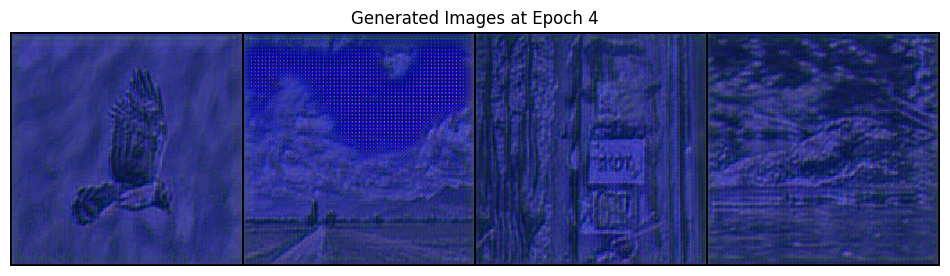

[Initialization Epoch 5/30] [Batch 0/25] [Content Loss: 0.9012064337730408]
[Initialization Epoch 5/30] [Batch 1/25] [Content Loss: 0.7761538624763489]
[Initialization Epoch 5/30] [Batch 2/25] [Content Loss: 0.7892886996269226]
[Initialization Epoch 5/30] [Batch 3/25] [Content Loss: 0.926284670829773]
[Initialization Epoch 5/30] [Batch 4/25] [Content Loss: 0.6605168581008911]
[Initialization Epoch 5/30] [Batch 5/25] [Content Loss: 0.7763369083404541]
[Initialization Epoch 5/30] [Batch 6/25] [Content Loss: 0.709869921207428]
[Initialization Epoch 5/30] [Batch 7/25] [Content Loss: 0.9381964206695557]
[Initialization Epoch 5/30] [Batch 8/25] [Content Loss: 0.7273730635643005]
[Initialization Epoch 5/30] [Batch 9/25] [Content Loss: 0.6230380535125732]
[Initialization Epoch 5/30] [Batch 10/25] [Content Loss: 0.6441600322723389]
[Initialization Epoch 5/30] [Batch 11/25] [Content Loss: 0.67803555727005]
[Initialization Epoch 5/30] [Batch 12/25] [Content Loss: 0.6555635333061218]
[Initializati

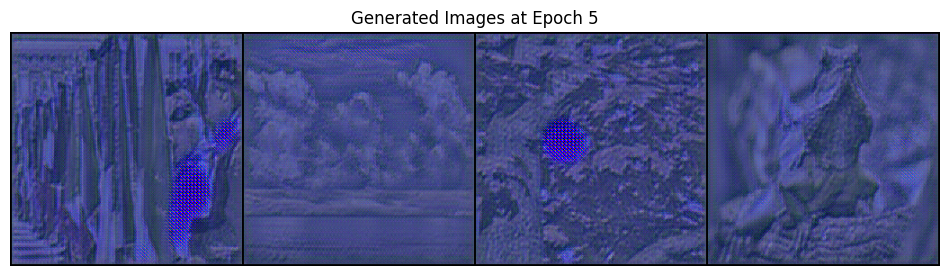

[Initialization Epoch 6/30] [Batch 0/25] [Content Loss: 0.7268483638763428]
[Initialization Epoch 6/30] [Batch 1/25] [Content Loss: 0.8236997127532959]
[Initialization Epoch 6/30] [Batch 2/25] [Content Loss: 0.9080837965011597]
[Initialization Epoch 6/30] [Batch 3/25] [Content Loss: 0.8986765146255493]
[Initialization Epoch 6/30] [Batch 4/25] [Content Loss: 0.916833221912384]
[Initialization Epoch 6/30] [Batch 5/25] [Content Loss: 0.7568967342376709]
[Initialization Epoch 6/30] [Batch 6/25] [Content Loss: 0.8129152655601501]
[Initialization Epoch 6/30] [Batch 7/25] [Content Loss: 0.7780572772026062]
[Initialization Epoch 6/30] [Batch 8/25] [Content Loss: 0.6457092761993408]
[Initialization Epoch 6/30] [Batch 9/25] [Content Loss: 0.823648989200592]
[Initialization Epoch 6/30] [Batch 10/25] [Content Loss: 0.7024877667427063]
[Initialization Epoch 6/30] [Batch 11/25] [Content Loss: 0.6495406031608582]
[Initialization Epoch 6/30] [Batch 12/25] [Content Loss: 0.7224646806716919]
[Initializa

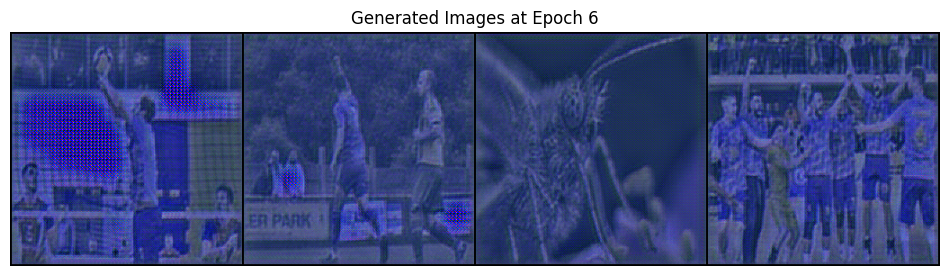

[Initialization Epoch 7/30] [Batch 0/25] [Content Loss: 0.7347446084022522]
[Initialization Epoch 7/30] [Batch 1/25] [Content Loss: 0.7911259531974792]
[Initialization Epoch 7/30] [Batch 2/25] [Content Loss: 0.8440929651260376]
[Initialization Epoch 7/30] [Batch 3/25] [Content Loss: 0.7446063756942749]
[Initialization Epoch 7/30] [Batch 4/25] [Content Loss: 0.656919538974762]
[Initialization Epoch 7/30] [Batch 5/25] [Content Loss: 0.5615805387496948]
[Initialization Epoch 7/30] [Batch 6/25] [Content Loss: 0.8511828184127808]
[Initialization Epoch 7/30] [Batch 7/25] [Content Loss: 0.798570990562439]
[Initialization Epoch 7/30] [Batch 8/25] [Content Loss: 0.7705203294754028]
[Initialization Epoch 7/30] [Batch 9/25] [Content Loss: 0.7667706608772278]
[Initialization Epoch 7/30] [Batch 10/25] [Content Loss: 0.5448167324066162]
[Initialization Epoch 7/30] [Batch 11/25] [Content Loss: 0.8629422783851624]
[Initialization Epoch 7/30] [Batch 12/25] [Content Loss: 0.7665968537330627]
[Initializa

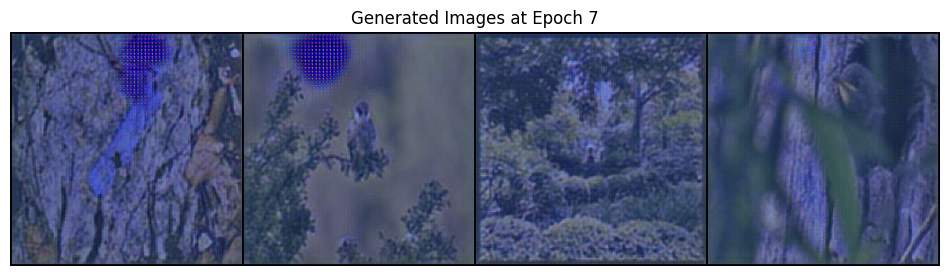

[Initialization Epoch 8/30] [Batch 0/25] [Content Loss: 0.7498074769973755]
[Initialization Epoch 8/30] [Batch 1/25] [Content Loss: 0.9016585946083069]
[Initialization Epoch 8/30] [Batch 2/25] [Content Loss: 0.5728424787521362]
[Initialization Epoch 8/30] [Batch 3/25] [Content Loss: 0.7412328720092773]
[Initialization Epoch 8/30] [Batch 4/25] [Content Loss: 0.7490776777267456]
[Initialization Epoch 8/30] [Batch 5/25] [Content Loss: 0.6511269807815552]
[Initialization Epoch 8/30] [Batch 6/25] [Content Loss: 0.6474067568778992]
[Initialization Epoch 8/30] [Batch 7/25] [Content Loss: 0.6913043856620789]
[Initialization Epoch 8/30] [Batch 8/25] [Content Loss: 0.600437343120575]
[Initialization Epoch 8/30] [Batch 9/25] [Content Loss: 0.5155147910118103]
[Initialization Epoch 8/30] [Batch 10/25] [Content Loss: 0.5559471845626831]
[Initialization Epoch 8/30] [Batch 11/25] [Content Loss: 0.5472089052200317]
[Initialization Epoch 8/30] [Batch 12/25] [Content Loss: 0.7094968557357788]
[Initializ

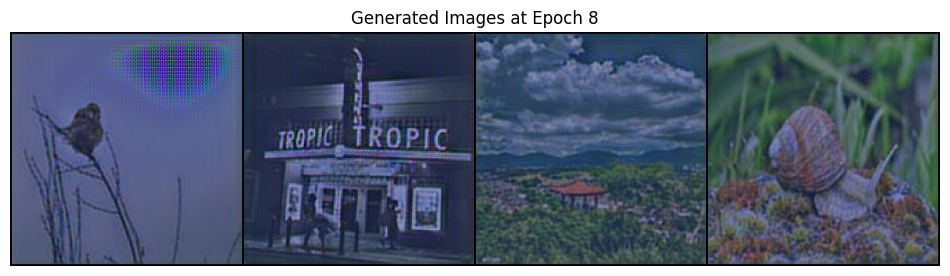

[Initialization Epoch 9/30] [Batch 0/25] [Content Loss: 0.5152201652526855]
[Initialization Epoch 9/30] [Batch 1/25] [Content Loss: 0.5891292095184326]
[Initialization Epoch 9/30] [Batch 2/25] [Content Loss: 0.8355706334114075]
[Initialization Epoch 9/30] [Batch 3/25] [Content Loss: 0.6368284821510315]
[Initialization Epoch 9/30] [Batch 4/25] [Content Loss: 0.5736761093139648]
[Initialization Epoch 9/30] [Batch 5/25] [Content Loss: 0.5271221399307251]
[Initialization Epoch 9/30] [Batch 6/25] [Content Loss: 0.7765832543373108]
[Initialization Epoch 9/30] [Batch 7/25] [Content Loss: 0.6924353837966919]
[Initialization Epoch 9/30] [Batch 8/25] [Content Loss: 0.5881133079528809]
[Initialization Epoch 9/30] [Batch 9/25] [Content Loss: 0.5589843988418579]
[Initialization Epoch 9/30] [Batch 10/25] [Content Loss: 0.6618513464927673]
[Initialization Epoch 9/30] [Batch 11/25] [Content Loss: 0.6543706655502319]
[Initialization Epoch 9/30] [Batch 12/25] [Content Loss: 0.6087559461593628]
[Initiali

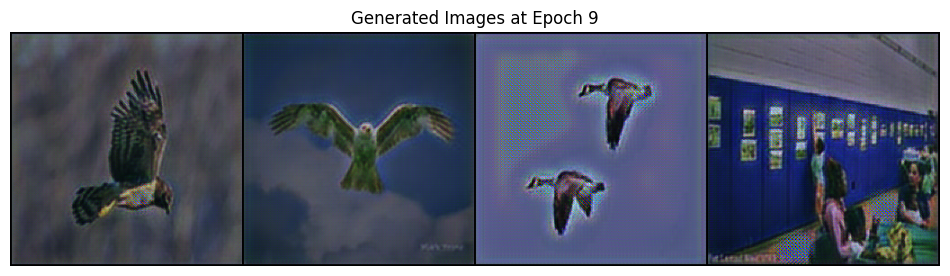

[Initialization Epoch 10/30] [Batch 0/25] [Content Loss: 0.6294018626213074]
[Initialization Epoch 10/30] [Batch 1/25] [Content Loss: 0.6282144784927368]
[Initialization Epoch 10/30] [Batch 2/25] [Content Loss: 0.6915993690490723]
[Initialization Epoch 10/30] [Batch 3/25] [Content Loss: 0.6153510808944702]
[Initialization Epoch 10/30] [Batch 4/25] [Content Loss: 0.5512732863426208]
[Initialization Epoch 10/30] [Batch 5/25] [Content Loss: 0.6787371039390564]
[Initialization Epoch 10/30] [Batch 6/25] [Content Loss: 0.6984178423881531]
[Initialization Epoch 10/30] [Batch 7/25] [Content Loss: 0.5067175626754761]
[Initialization Epoch 10/30] [Batch 8/25] [Content Loss: 0.5001441240310669]
[Initialization Epoch 10/30] [Batch 9/25] [Content Loss: 0.5047032833099365]
[Initialization Epoch 10/30] [Batch 10/25] [Content Loss: 0.6196237802505493]
[Initialization Epoch 10/30] [Batch 11/25] [Content Loss: 0.5249903202056885]
[Initialization Epoch 10/30] [Batch 12/25] [Content Loss: 0.55623257160186

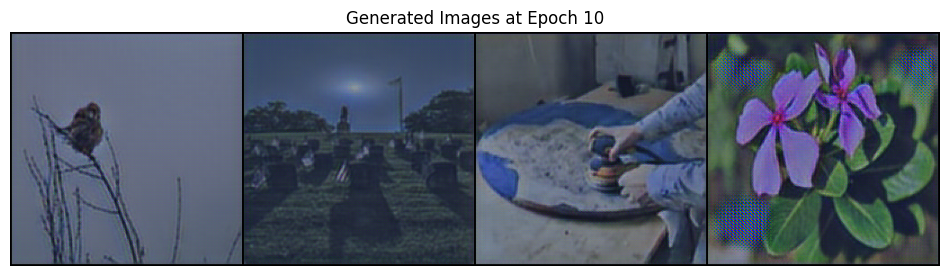

[Initialization Epoch 11/30] [Batch 0/25] [Content Loss: 0.5486605763435364]
[Initialization Epoch 11/30] [Batch 1/25] [Content Loss: 0.5084102749824524]
[Initialization Epoch 11/30] [Batch 2/25] [Content Loss: 0.5240522623062134]
[Initialization Epoch 11/30] [Batch 3/25] [Content Loss: 0.48917099833488464]
[Initialization Epoch 11/30] [Batch 4/25] [Content Loss: 0.5551621317863464]
[Initialization Epoch 11/30] [Batch 5/25] [Content Loss: 0.542649507522583]
[Initialization Epoch 11/30] [Batch 6/25] [Content Loss: 0.5247711539268494]
[Initialization Epoch 11/30] [Batch 7/25] [Content Loss: 0.4684953987598419]
[Initialization Epoch 11/30] [Batch 8/25] [Content Loss: 0.4552367329597473]
[Initialization Epoch 11/30] [Batch 9/25] [Content Loss: 0.5217862129211426]
[Initialization Epoch 11/30] [Batch 10/25] [Content Loss: 0.5531338453292847]
[Initialization Epoch 11/30] [Batch 11/25] [Content Loss: 0.4592684507369995]
[Initialization Epoch 11/30] [Batch 12/25] [Content Loss: 0.42147240042686

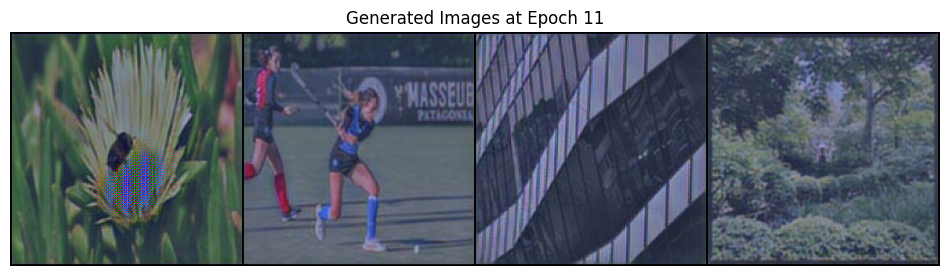

[Initialization Epoch 12/30] [Batch 0/25] [Content Loss: 0.5066701769828796]
[Initialization Epoch 12/30] [Batch 1/25] [Content Loss: 0.5845661759376526]
[Initialization Epoch 12/30] [Batch 2/25] [Content Loss: 0.45050135254859924]
[Initialization Epoch 12/30] [Batch 3/25] [Content Loss: 0.5784156918525696]
[Initialization Epoch 12/30] [Batch 4/25] [Content Loss: 0.4988550543785095]
[Initialization Epoch 12/30] [Batch 5/25] [Content Loss: 0.4472331702709198]
[Initialization Epoch 12/30] [Batch 6/25] [Content Loss: 0.4008531868457794]
[Initialization Epoch 12/30] [Batch 7/25] [Content Loss: 0.6528723835945129]
[Initialization Epoch 12/30] [Batch 8/25] [Content Loss: 0.5318070650100708]
[Initialization Epoch 12/30] [Batch 9/25] [Content Loss: 0.6441497206687927]
[Initialization Epoch 12/30] [Batch 10/25] [Content Loss: 0.741683840751648]
[Initialization Epoch 12/30] [Batch 11/25] [Content Loss: 0.7013533115386963]
[Initialization Epoch 12/30] [Batch 12/25] [Content Loss: 0.58978509902954

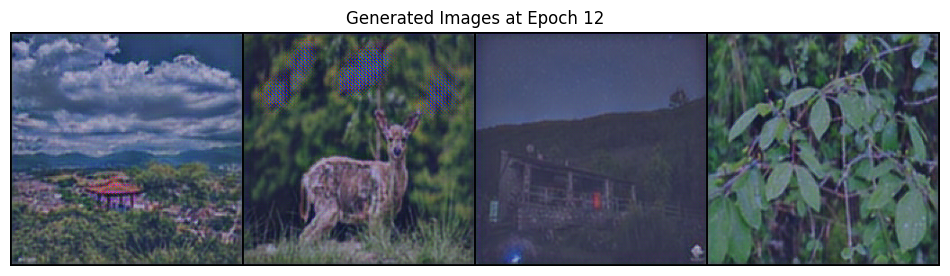

[Initialization Epoch 13/30] [Batch 0/25] [Content Loss: 0.5813201665878296]
[Initialization Epoch 13/30] [Batch 1/25] [Content Loss: 0.594325065612793]
[Initialization Epoch 13/30] [Batch 2/25] [Content Loss: 0.5183303952217102]
[Initialization Epoch 13/30] [Batch 3/25] [Content Loss: 0.49130526185035706]
[Initialization Epoch 13/30] [Batch 4/25] [Content Loss: 0.6211204528808594]
[Initialization Epoch 13/30] [Batch 5/25] [Content Loss: 0.4197269082069397]
[Initialization Epoch 13/30] [Batch 6/25] [Content Loss: 0.5970393419265747]
[Initialization Epoch 13/30] [Batch 7/25] [Content Loss: 0.5231359004974365]
[Initialization Epoch 13/30] [Batch 8/25] [Content Loss: 0.5092509984970093]
[Initialization Epoch 13/30] [Batch 9/25] [Content Loss: 0.532717764377594]
[Initialization Epoch 13/30] [Batch 10/25] [Content Loss: 0.5452139973640442]
[Initialization Epoch 13/30] [Batch 11/25] [Content Loss: 0.5422002673149109]
[Initialization Epoch 13/30] [Batch 12/25] [Content Loss: 0.507685482501983

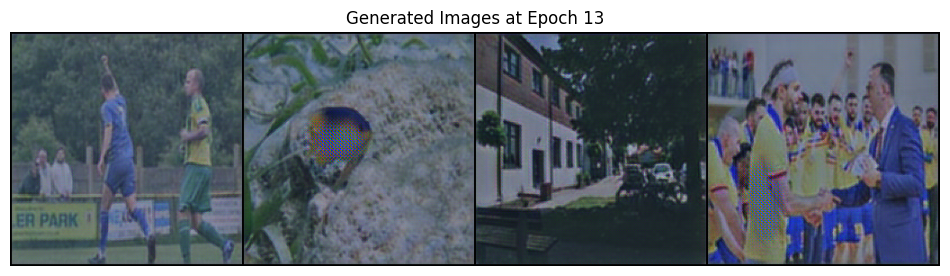

[Initialization Epoch 14/30] [Batch 0/25] [Content Loss: 0.764744758605957]
[Initialization Epoch 14/30] [Batch 1/25] [Content Loss: 0.46631190180778503]
[Initialization Epoch 14/30] [Batch 2/25] [Content Loss: 0.4298893213272095]
[Initialization Epoch 14/30] [Batch 3/25] [Content Loss: 0.5674492120742798]
[Initialization Epoch 14/30] [Batch 4/25] [Content Loss: 0.6285427212715149]
[Initialization Epoch 14/30] [Batch 5/25] [Content Loss: 0.6284687519073486]
[Initialization Epoch 14/30] [Batch 6/25] [Content Loss: 0.6236135959625244]
[Initialization Epoch 14/30] [Batch 7/25] [Content Loss: 0.538780152797699]
[Initialization Epoch 14/30] [Batch 8/25] [Content Loss: 0.6295838356018066]
[Initialization Epoch 14/30] [Batch 9/25] [Content Loss: 0.4129713475704193]
[Initialization Epoch 14/30] [Batch 10/25] [Content Loss: 0.49650633335113525]
[Initialization Epoch 14/30] [Batch 11/25] [Content Loss: 0.4769834280014038]
[Initialization Epoch 14/30] [Batch 12/25] [Content Loss: 0.35999080538749

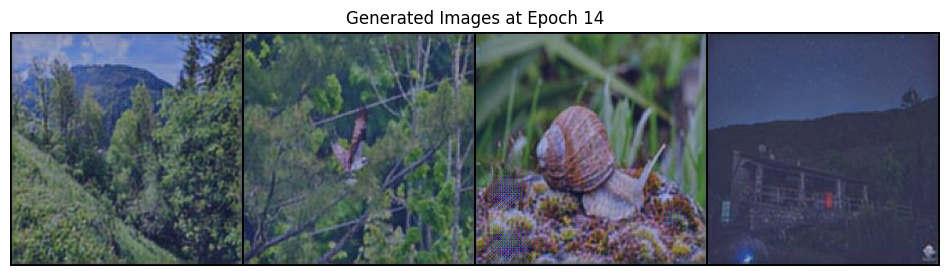

[Initialization Epoch 15/30] [Batch 0/25] [Content Loss: 0.3721836507320404]
[Initialization Epoch 15/30] [Batch 1/25] [Content Loss: 0.4285242259502411]
[Initialization Epoch 15/30] [Batch 2/25] [Content Loss: 0.5934180021286011]
[Initialization Epoch 15/30] [Batch 3/25] [Content Loss: 0.5259774923324585]
[Initialization Epoch 15/30] [Batch 4/25] [Content Loss: 0.533486008644104]
[Initialization Epoch 15/30] [Batch 5/25] [Content Loss: 0.5161401629447937]
[Initialization Epoch 15/30] [Batch 6/25] [Content Loss: 0.46412691473960876]
[Initialization Epoch 15/30] [Batch 7/25] [Content Loss: 0.5144944787025452]
[Initialization Epoch 15/30] [Batch 8/25] [Content Loss: 0.570706844329834]
[Initialization Epoch 15/30] [Batch 9/25] [Content Loss: 0.5451110601425171]
[Initialization Epoch 15/30] [Batch 10/25] [Content Loss: 0.6716156005859375]
[Initialization Epoch 15/30] [Batch 11/25] [Content Loss: 0.5931932926177979]
[Initialization Epoch 15/30] [Batch 12/25] [Content Loss: 0.497958958148956

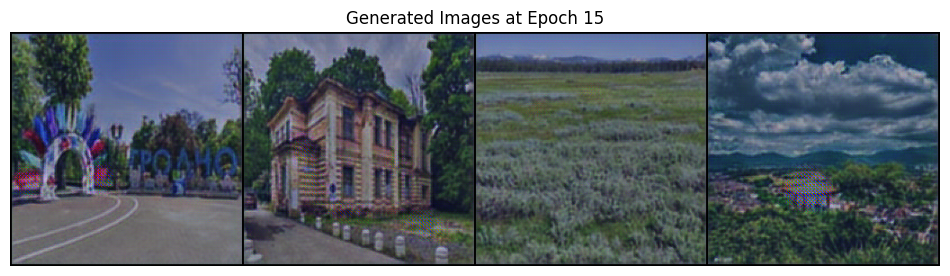

[Initialization Epoch 16/30] [Batch 0/25] [Content Loss: 0.405351459980011]
[Initialization Epoch 16/30] [Batch 1/25] [Content Loss: 0.7235692739486694]
[Initialization Epoch 16/30] [Batch 2/25] [Content Loss: 0.6328195929527283]
[Initialization Epoch 16/30] [Batch 3/25] [Content Loss: 0.4898405969142914]
[Initialization Epoch 16/30] [Batch 4/25] [Content Loss: 0.4464544653892517]
[Initialization Epoch 16/30] [Batch 5/25] [Content Loss: 0.7210742235183716]
[Initialization Epoch 16/30] [Batch 6/25] [Content Loss: 0.5328467488288879]
[Initialization Epoch 16/30] [Batch 7/25] [Content Loss: 0.45275261998176575]
[Initialization Epoch 16/30] [Batch 8/25] [Content Loss: 0.5334070324897766]
[Initialization Epoch 16/30] [Batch 9/25] [Content Loss: 0.4031027853488922]
[Initialization Epoch 16/30] [Batch 10/25] [Content Loss: 0.6122233271598816]
[Initialization Epoch 16/30] [Batch 11/25] [Content Loss: 0.7111654281616211]
[Initialization Epoch 16/30] [Batch 12/25] [Content Loss: 0.39242547750473

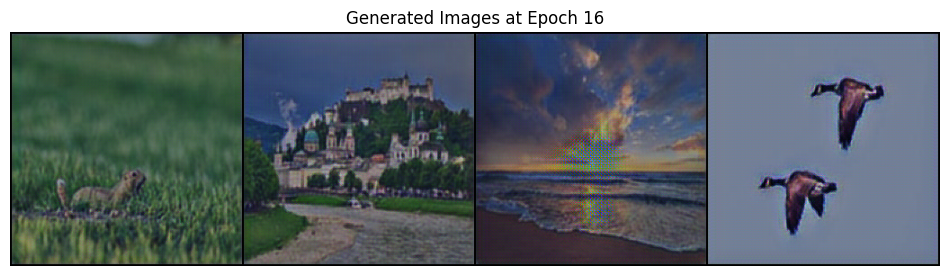

[Initialization Epoch 17/30] [Batch 0/25] [Content Loss: 0.5868067741394043]
[Initialization Epoch 17/30] [Batch 1/25] [Content Loss: 0.4378872513771057]
[Initialization Epoch 17/30] [Batch 2/25] [Content Loss: 0.5406147241592407]
[Initialization Epoch 17/30] [Batch 3/25] [Content Loss: 0.4603806436061859]
[Initialization Epoch 17/30] [Batch 4/25] [Content Loss: 0.5187147855758667]
[Initialization Epoch 17/30] [Batch 5/25] [Content Loss: 0.6668463349342346]
[Initialization Epoch 17/30] [Batch 6/25] [Content Loss: 0.4703986644744873]
[Initialization Epoch 17/30] [Batch 7/25] [Content Loss: 0.4032127857208252]
[Initialization Epoch 17/30] [Batch 8/25] [Content Loss: 0.4005637764930725]
[Initialization Epoch 17/30] [Batch 9/25] [Content Loss: 0.3973437547683716]
[Initialization Epoch 17/30] [Batch 10/25] [Content Loss: 0.5626885890960693]
[Initialization Epoch 17/30] [Batch 11/25] [Content Loss: 0.4237363636493683]
[Initialization Epoch 17/30] [Batch 12/25] [Content Loss: 0.37043815851211

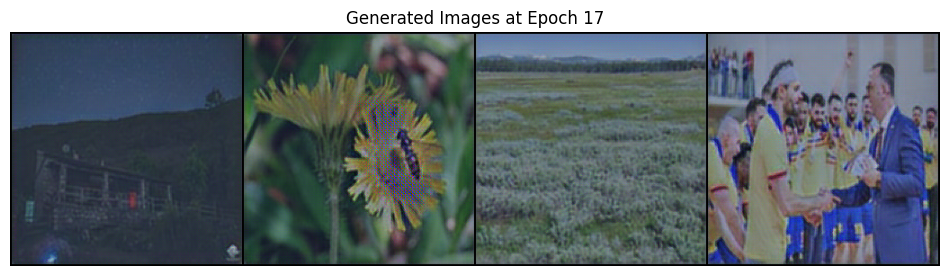

[Initialization Epoch 18/30] [Batch 0/25] [Content Loss: 0.4615330994129181]
[Initialization Epoch 18/30] [Batch 1/25] [Content Loss: 0.43641382455825806]
[Initialization Epoch 18/30] [Batch 2/25] [Content Loss: 0.45828714966773987]
[Initialization Epoch 18/30] [Batch 3/25] [Content Loss: 0.3870104253292084]
[Initialization Epoch 18/30] [Batch 4/25] [Content Loss: 0.44373175501823425]
[Initialization Epoch 18/30] [Batch 5/25] [Content Loss: 0.4726344048976898]
[Initialization Epoch 18/30] [Batch 6/25] [Content Loss: 0.42112523317337036]
[Initialization Epoch 18/30] [Batch 7/25] [Content Loss: 0.6496567726135254]
[Initialization Epoch 18/30] [Batch 8/25] [Content Loss: 0.4947201609611511]
[Initialization Epoch 18/30] [Batch 9/25] [Content Loss: 0.37247395515441895]
[Initialization Epoch 18/30] [Batch 10/25] [Content Loss: 0.5186197757720947]
[Initialization Epoch 18/30] [Batch 11/25] [Content Loss: 0.44359955191612244]
[Initialization Epoch 18/30] [Batch 12/25] [Content Loss: 0.37221896

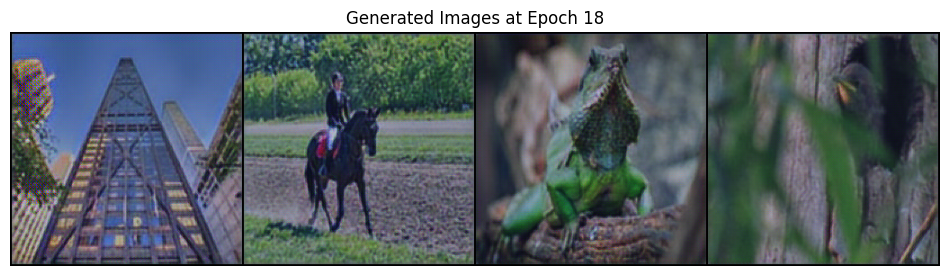

[Initialization Epoch 19/30] [Batch 0/25] [Content Loss: 0.4041604995727539]
[Initialization Epoch 19/30] [Batch 1/25] [Content Loss: 0.5171775221824646]
[Initialization Epoch 19/30] [Batch 2/25] [Content Loss: 0.4651036560535431]
[Initialization Epoch 19/30] [Batch 3/25] [Content Loss: 0.45706313848495483]
[Initialization Epoch 19/30] [Batch 4/25] [Content Loss: 0.4178774356842041]
[Initialization Epoch 19/30] [Batch 5/25] [Content Loss: 0.36159998178482056]
[Initialization Epoch 19/30] [Batch 6/25] [Content Loss: 0.4388349652290344]
[Initialization Epoch 19/30] [Batch 7/25] [Content Loss: 0.5573753118515015]
[Initialization Epoch 19/30] [Batch 8/25] [Content Loss: 0.573192298412323]
[Initialization Epoch 19/30] [Batch 9/25] [Content Loss: 0.5477811098098755]
[Initialization Epoch 19/30] [Batch 10/25] [Content Loss: 0.33673736453056335]
[Initialization Epoch 19/30] [Batch 11/25] [Content Loss: 0.523489773273468]
[Initialization Epoch 19/30] [Batch 12/25] [Content Loss: 0.5176053643226

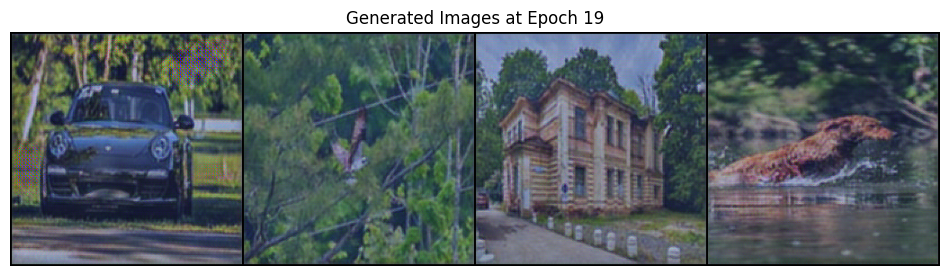

[Initialization Epoch 20/30] [Batch 0/25] [Content Loss: 0.6442222595214844]
[Initialization Epoch 20/30] [Batch 1/25] [Content Loss: 0.6507812738418579]
[Initialization Epoch 20/30] [Batch 2/25] [Content Loss: 0.443808913230896]
[Initialization Epoch 20/30] [Batch 3/25] [Content Loss: 0.5574719905853271]
[Initialization Epoch 20/30] [Batch 4/25] [Content Loss: 0.5102543830871582]
[Initialization Epoch 20/30] [Batch 5/25] [Content Loss: 0.4026845097541809]
[Initialization Epoch 20/30] [Batch 6/25] [Content Loss: 0.49994900822639465]
[Initialization Epoch 20/30] [Batch 7/25] [Content Loss: 0.4388602375984192]
[Initialization Epoch 20/30] [Batch 8/25] [Content Loss: 0.4654875099658966]
[Initialization Epoch 20/30] [Batch 9/25] [Content Loss: 0.41326606273651123]
[Initialization Epoch 20/30] [Batch 10/25] [Content Loss: 0.3831605613231659]
[Initialization Epoch 20/30] [Batch 11/25] [Content Loss: 0.4526362419128418]
[Initialization Epoch 20/30] [Batch 12/25] [Content Loss: 0.5071020126342

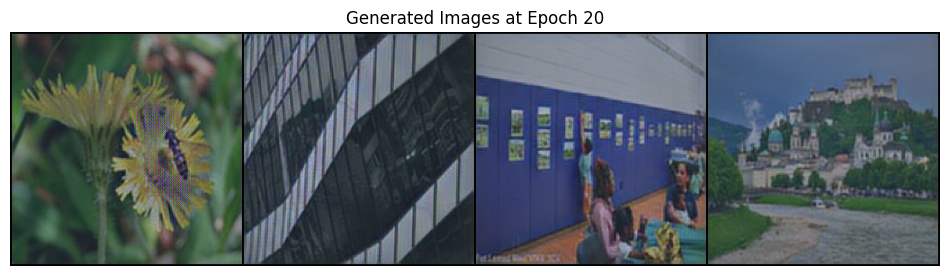

[Initialization Epoch 21/30] [Batch 0/25] [Content Loss: 0.43706825375556946]
[Initialization Epoch 21/30] [Batch 1/25] [Content Loss: 0.4166744649410248]
[Initialization Epoch 21/30] [Batch 2/25] [Content Loss: 0.3631468415260315]
[Initialization Epoch 21/30] [Batch 3/25] [Content Loss: 0.4966433048248291]
[Initialization Epoch 21/30] [Batch 4/25] [Content Loss: 0.4530501067638397]
[Initialization Epoch 21/30] [Batch 5/25] [Content Loss: 0.4428885877132416]
[Initialization Epoch 21/30] [Batch 6/25] [Content Loss: 0.5384925603866577]
[Initialization Epoch 21/30] [Batch 7/25] [Content Loss: 0.3136303722858429]
[Initialization Epoch 21/30] [Batch 8/25] [Content Loss: 0.442898690700531]
[Initialization Epoch 21/30] [Batch 9/25] [Content Loss: 0.4936734139919281]
[Initialization Epoch 21/30] [Batch 10/25] [Content Loss: 0.5109182000160217]
[Initialization Epoch 21/30] [Batch 11/25] [Content Loss: 0.5324807167053223]
[Initialization Epoch 21/30] [Batch 12/25] [Content Loss: 0.45934882760047

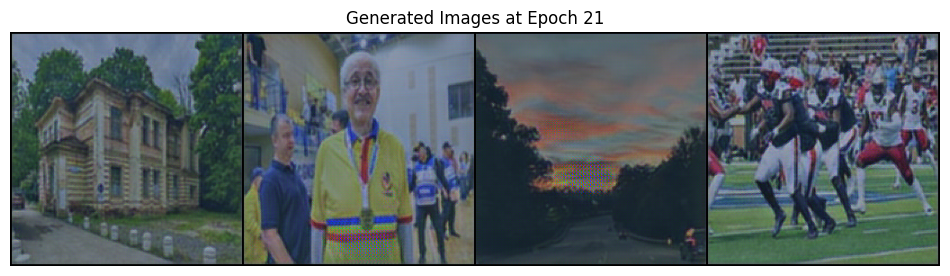

[Initialization Epoch 22/30] [Batch 0/25] [Content Loss: 0.4561978876590729]
[Initialization Epoch 22/30] [Batch 1/25] [Content Loss: 0.3833082318305969]
[Initialization Epoch 22/30] [Batch 2/25] [Content Loss: 0.46799221634864807]
[Initialization Epoch 22/30] [Batch 3/25] [Content Loss: 0.5993342399597168]
[Initialization Epoch 22/30] [Batch 4/25] [Content Loss: 0.4200456440448761]
[Initialization Epoch 22/30] [Batch 5/25] [Content Loss: 0.4332868158817291]
[Initialization Epoch 22/30] [Batch 6/25] [Content Loss: 0.5051332712173462]
[Initialization Epoch 22/30] [Batch 7/25] [Content Loss: 0.49847346544265747]
[Initialization Epoch 22/30] [Batch 8/25] [Content Loss: 0.5977778434753418]
[Initialization Epoch 22/30] [Batch 9/25] [Content Loss: 0.43945151567459106]
[Initialization Epoch 22/30] [Batch 10/25] [Content Loss: 0.4329386353492737]
[Initialization Epoch 22/30] [Batch 11/25] [Content Loss: 0.6080493927001953]
[Initialization Epoch 22/30] [Batch 12/25] [Content Loss: 0.46216398477

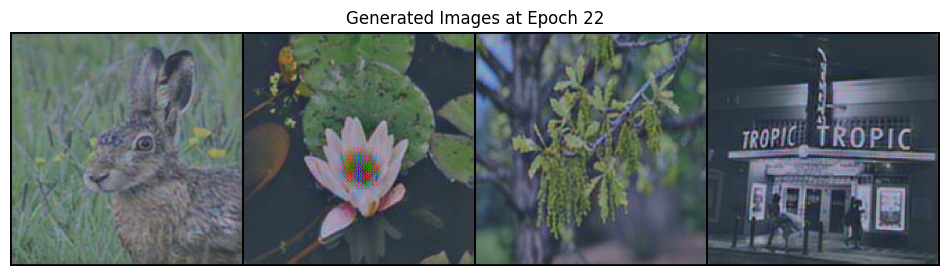

[Initialization Epoch 23/30] [Batch 0/25] [Content Loss: 0.5593130588531494]
[Initialization Epoch 23/30] [Batch 1/25] [Content Loss: 0.40025925636291504]
[Initialization Epoch 23/30] [Batch 2/25] [Content Loss: 0.546393632888794]
[Initialization Epoch 23/30] [Batch 3/25] [Content Loss: 0.37810570001602173]
[Initialization Epoch 23/30] [Batch 4/25] [Content Loss: 0.4865182340145111]
[Initialization Epoch 23/30] [Batch 5/25] [Content Loss: 0.40670785307884216]
[Initialization Epoch 23/30] [Batch 6/25] [Content Loss: 0.36313456296920776]
[Initialization Epoch 23/30] [Batch 7/25] [Content Loss: 0.4375961422920227]
[Initialization Epoch 23/30] [Batch 8/25] [Content Loss: 0.3497971296310425]
[Initialization Epoch 23/30] [Batch 9/25] [Content Loss: 0.45945504307746887]
[Initialization Epoch 23/30] [Batch 10/25] [Content Loss: 0.5277354717254639]
[Initialization Epoch 23/30] [Batch 11/25] [Content Loss: 0.5024285912513733]
[Initialization Epoch 23/30] [Batch 12/25] [Content Loss: 0.5418876409

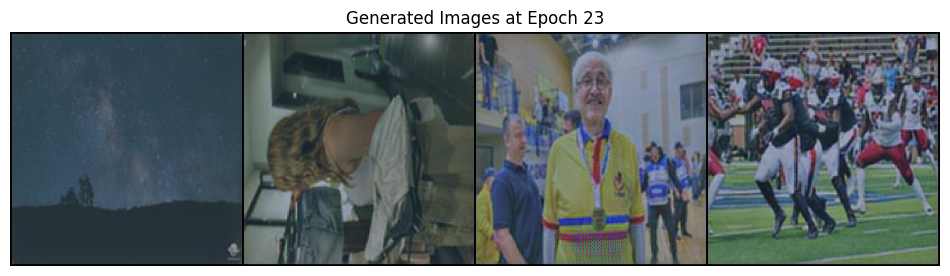

[Initialization Epoch 24/30] [Batch 0/25] [Content Loss: 0.4340915083885193]
[Initialization Epoch 24/30] [Batch 1/25] [Content Loss: 0.40659934282302856]
[Initialization Epoch 24/30] [Batch 2/25] [Content Loss: 0.5120338201522827]
[Initialization Epoch 24/30] [Batch 3/25] [Content Loss: 0.4756912589073181]
[Initialization Epoch 24/30] [Batch 4/25] [Content Loss: 0.5819255113601685]
[Initialization Epoch 24/30] [Batch 5/25] [Content Loss: 0.5598748326301575]
[Initialization Epoch 24/30] [Batch 6/25] [Content Loss: 0.47754955291748047]
[Initialization Epoch 24/30] [Batch 7/25] [Content Loss: 0.46103012561798096]
[Initialization Epoch 24/30] [Batch 8/25] [Content Loss: 0.6630150079727173]
[Initialization Epoch 24/30] [Batch 9/25] [Content Loss: 0.43191367387771606]
[Initialization Epoch 24/30] [Batch 10/25] [Content Loss: 0.5039592981338501]
[Initialization Epoch 24/30] [Batch 11/25] [Content Loss: 0.4834931492805481]
[Initialization Epoch 24/30] [Batch 12/25] [Content Loss: 0.4048408865

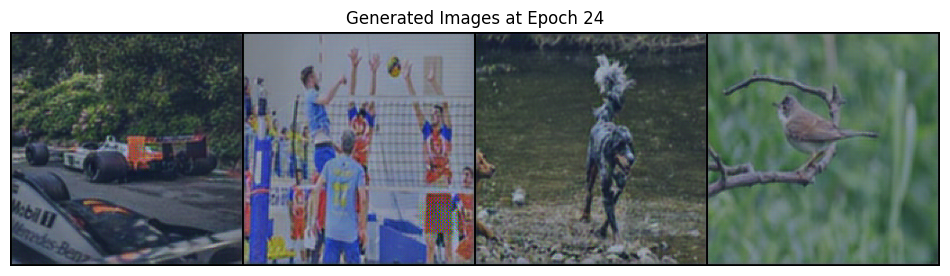

[Initialization Epoch 25/30] [Batch 0/25] [Content Loss: 0.41486555337905884]
[Initialization Epoch 25/30] [Batch 1/25] [Content Loss: 0.39207255840301514]
[Initialization Epoch 25/30] [Batch 2/25] [Content Loss: 0.4735580086708069]
[Initialization Epoch 25/30] [Batch 3/25] [Content Loss: 0.3925192356109619]
[Initialization Epoch 25/30] [Batch 4/25] [Content Loss: 0.4222009479999542]
[Initialization Epoch 25/30] [Batch 5/25] [Content Loss: 0.36393797397613525]
[Initialization Epoch 25/30] [Batch 6/25] [Content Loss: 0.5370579957962036]
[Initialization Epoch 25/30] [Batch 7/25] [Content Loss: 0.583030104637146]
[Initialization Epoch 25/30] [Batch 8/25] [Content Loss: 0.41782864928245544]
[Initialization Epoch 25/30] [Batch 9/25] [Content Loss: 0.46195557713508606]
[Initialization Epoch 25/30] [Batch 10/25] [Content Loss: 0.48938286304473877]
[Initialization Epoch 25/30] [Batch 11/25] [Content Loss: 0.4466556906700134]
[Initialization Epoch 25/30] [Batch 12/25] [Content Loss: 0.455266058

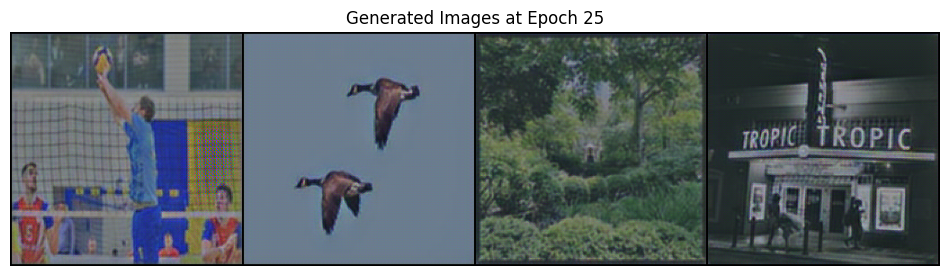

[Initialization Epoch 26/30] [Batch 0/25] [Content Loss: 0.6722287535667419]
[Initialization Epoch 26/30] [Batch 1/25] [Content Loss: 0.5592060685157776]
[Initialization Epoch 26/30] [Batch 2/25] [Content Loss: 0.4565560817718506]
[Initialization Epoch 26/30] [Batch 3/25] [Content Loss: 0.3749510645866394]
[Initialization Epoch 26/30] [Batch 4/25] [Content Loss: 0.4468938112258911]
[Initialization Epoch 26/30] [Batch 5/25] [Content Loss: 0.5115336179733276]
[Initialization Epoch 26/30] [Batch 6/25] [Content Loss: 0.3950519561767578]
[Initialization Epoch 26/30] [Batch 7/25] [Content Loss: 0.4054264426231384]
[Initialization Epoch 26/30] [Batch 8/25] [Content Loss: 0.4289207458496094]
[Initialization Epoch 26/30] [Batch 9/25] [Content Loss: 0.4498254656791687]
[Initialization Epoch 26/30] [Batch 10/25] [Content Loss: 0.4326868951320648]
[Initialization Epoch 26/30] [Batch 11/25] [Content Loss: 0.4575439691543579]
[Initialization Epoch 26/30] [Batch 12/25] [Content Loss: 0.51416265964508

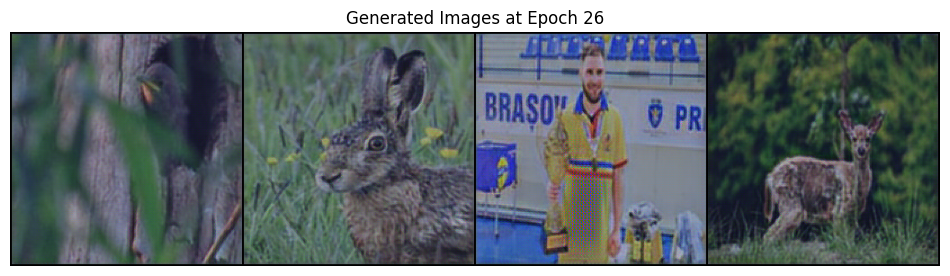

[Initialization Epoch 27/30] [Batch 0/25] [Content Loss: 0.39585161209106445]
[Initialization Epoch 27/30] [Batch 1/25] [Content Loss: 0.4741196632385254]
[Initialization Epoch 27/30] [Batch 2/25] [Content Loss: 0.5973225831985474]
[Initialization Epoch 27/30] [Batch 3/25] [Content Loss: 0.3553766906261444]
[Initialization Epoch 27/30] [Batch 4/25] [Content Loss: 0.4228476881980896]
[Initialization Epoch 27/30] [Batch 5/25] [Content Loss: 0.6289504170417786]
[Initialization Epoch 27/30] [Batch 6/25] [Content Loss: 0.379767507314682]
[Initialization Epoch 27/30] [Batch 7/25] [Content Loss: 0.4344409108161926]
[Initialization Epoch 27/30] [Batch 8/25] [Content Loss: 0.5572154521942139]
[Initialization Epoch 27/30] [Batch 9/25] [Content Loss: 0.5883336067199707]
[Initialization Epoch 27/30] [Batch 10/25] [Content Loss: 0.5004663467407227]
[Initialization Epoch 27/30] [Batch 11/25] [Content Loss: 0.5434808731079102]
[Initialization Epoch 27/30] [Batch 12/25] [Content Loss: 0.41542038321495

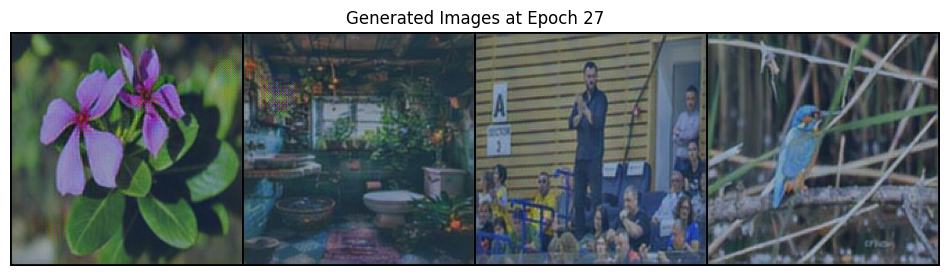

[Initialization Epoch 28/30] [Batch 0/25] [Content Loss: 0.43009793758392334]
[Initialization Epoch 28/30] [Batch 1/25] [Content Loss: 0.49299824237823486]
[Initialization Epoch 28/30] [Batch 2/25] [Content Loss: 0.5693298578262329]
[Initialization Epoch 28/30] [Batch 3/25] [Content Loss: 0.3762710392475128]
[Initialization Epoch 28/30] [Batch 4/25] [Content Loss: 0.6089125871658325]
[Initialization Epoch 28/30] [Batch 5/25] [Content Loss: 0.5082215070724487]
[Initialization Epoch 28/30] [Batch 6/25] [Content Loss: 0.43161606788635254]
[Initialization Epoch 28/30] [Batch 7/25] [Content Loss: 0.4416409730911255]
[Initialization Epoch 28/30] [Batch 8/25] [Content Loss: 0.37696653604507446]
[Initialization Epoch 28/30] [Batch 9/25] [Content Loss: 0.38191577792167664]
[Initialization Epoch 28/30] [Batch 10/25] [Content Loss: 0.48485612869262695]
[Initialization Epoch 28/30] [Batch 11/25] [Content Loss: 0.47227782011032104]
[Initialization Epoch 28/30] [Batch 12/25] [Content Loss: 0.5550023

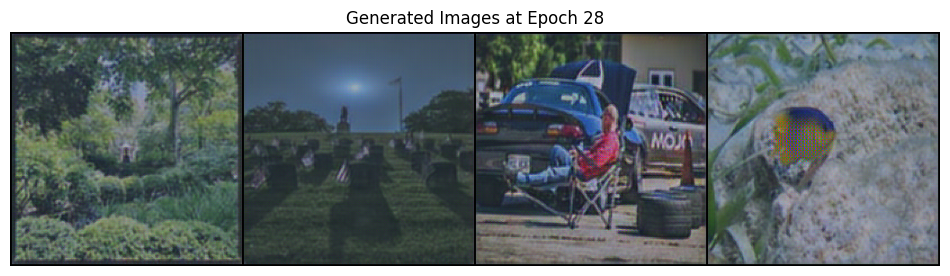

[Initialization Epoch 29/30] [Batch 0/25] [Content Loss: 0.4251375198364258]
[Initialization Epoch 29/30] [Batch 1/25] [Content Loss: 0.3553057312965393]
[Initialization Epoch 29/30] [Batch 2/25] [Content Loss: 0.48502612113952637]
[Initialization Epoch 29/30] [Batch 3/25] [Content Loss: 0.5022515058517456]
[Initialization Epoch 29/30] [Batch 4/25] [Content Loss: 0.48950791358947754]
[Initialization Epoch 29/30] [Batch 5/25] [Content Loss: 0.40459173917770386]
[Initialization Epoch 29/30] [Batch 6/25] [Content Loss: 0.47745606303215027]
[Initialization Epoch 29/30] [Batch 7/25] [Content Loss: 0.4566229581832886]
[Initialization Epoch 29/30] [Batch 8/25] [Content Loss: 0.3273248076438904]
[Initialization Epoch 29/30] [Batch 9/25] [Content Loss: 0.4396111071109772]
[Initialization Epoch 29/30] [Batch 10/25] [Content Loss: 0.5274689793586731]
[Initialization Epoch 29/30] [Batch 11/25] [Content Loss: 0.5811803340911865]
[Initialization Epoch 29/30] [Batch 12/25] [Content Loss: 0.5693358778

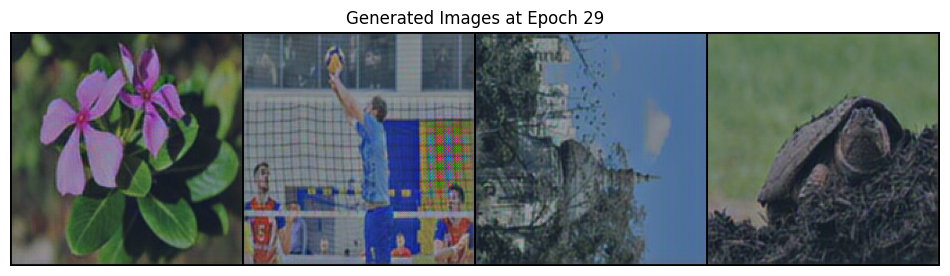

Initialization phase complete.


In [17]:
# Set CuDNN benchmark and deterministic flags
torch.backends.cudnn.benchmark = True
torch.backends.cudnn.deterministic = True

# Initialize models and optimizers
generator = Generator().to(device)
vgg_feature_extractor = VGGFeatureExtractor().to(device)

optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
scheduler_G = torch.optim.lr_scheduler.StepLR(optimizer_G, step_size=10, gamma=0.1)

scaler = GradScaler()

num_init_epochs = 30  # 10

# Function to display images
def display_images(images, epoch):
    grid_img = torchvision.utils.make_grid(images, nrow=4, normalize=True)
    np_img = grid_img.permute(1, 2, 0).cpu().numpy()
    np_img = (np_img * 255).astype(np.uint8)  # Convert to uint8 for display

    plt.figure(figsize=(12, 8))
    plt.imshow(np_img)
    plt.title(f"Generated Images at Epoch {epoch}")
    plt.axis('off')
    plt.show()

## Pre-train the generator with content loss only for Shinkai style
for epoch in range(num_init_epochs):
    for i, (imgs, _) in enumerate(real_train_dataloader):
        real_imgs = imgs.to(device)
        
        optimizer_G.zero_grad()
        with torch.cuda.amp.autocast():  # Mixed precision for better performance
            fake_imgs = generator(real_imgs)
            #real_features = vgg_feature_extractor(real_imgs)
            #fake_features = vgg_feature_extractor(fake_imgs)
            g_content_loss = content_loss(fake_imgs, real_imgs, vgg_feature_extractor)
        
        scaler.scale(g_content_loss).backward()
        scaler.step(optimizer_G)
        scaler.update()

        print(f"[Initialization Epoch {epoch}/{num_init_epochs}] [Batch {i}/{len(real_train_dataloader)}] [Content Loss: {g_content_loss.item()}]")
    scheduler_G.step()

    # Display generated images after each epoch
    display_images(fake_imgs.cpu().data, epoch)

    # Save the model checkpoint
    torch.save(generator.state_dict(), f"generator_checkpoint_epoch_{epoch}.pth")
print("Initialization phase complete.")



### Main Training Phase

- Adversarial + Content Loss

Display results after each epoch

In [23]:
def display_images(original_images, cartoonized_images, epoch):
    fig, axes = plt.subplots(2, len(original_images), figsize=(15, 6))
    for i in range(len(original_images)):
        axes[0, i].imshow(original_images[i].cpu().permute(1, 2, 0).numpy())
        axes[0, i].set_title("Original")
        axes[0, i].axis("off")
        axes[1, i].imshow(cartoonized_images[i].cpu().permute(1, 2, 0).numpy())
        axes[1, i].set_title("Cartoonized")
        axes[1, i].axis("off")
    plt.suptitle(f"Generated Images at Epoch {epoch}")
    plt.show()


Generate Samples function to aid variety in Generator

In [87]:
def generate_samples(generator, dataloader, num_samples=100, batch_size=32):
    generator.eval()
    samples = []
    count = 0
    with torch.no_grad():
        for real_imgs, _ in dataloader:
            real_imgs = real_imgs.to(device)
            generated_imgs = generator(real_imgs)
            samples.append(generated_imgs.cpu())
            count += real_imgs.size(0)
            if count >= num_samples:
                break
    samples = torch.cat(samples, dim=0)
    return samples[:num_samples]


Function for Inspection Score and FID
- Helps to evaluate how well the model is training

In [86]:
class ImageDataset(Dataset):
    def __init__(self, images, transform=None):
        self.images = images
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx].cpu().detach().numpy()
        image = (image * 255).astype(np.uint8)  # Assuming the image is normalized between -1 and 1
        image = image.transpose(1, 2, 0)  # Convert from CHW to HWC
        if self.transform:
            image = self.transform(image)
        return image

def calculate_inception_score(images, batch_size=32, splits=10):
    inception_model = inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1).to(device).eval()
    transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(299),
        transforms.CenterCrop(299),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    dataset = ImageDataset(images, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    preds = []
    for batch in dataloader:
        batch = batch.to(device)
        with torch.no_grad():
            pred = inception_model(batch)
            pred = F.softmax(pred, dim=1)
            preds.append(pred.cpu().numpy())
    preds = np.concatenate(preds, axis=0)

    print(f"Shape of predictions: {preds.shape}")
    print(f"Sample predictions: {preds[:5]}")

    if preds.ndim == 1:
        preds = preds[:, np.newaxis]

    preds = np.clip(preds, 1e-10, 1.0)

    scores = []
    for i in range(splits):
        part = preds[(i * preds.shape[0] // splits):((i + 1) * preds.shape[0] // splits), :]
        if part.size == 0:
            print(f"Warning: Part is empty at split {i}")
            continue
        kl = part * (np.log(part) - np.log(np.expand_dims(np.mean(part, 0), 0)))
        kl = np.mean(np.sum(kl, 1))
        if np.isnan(kl):
            print(f"Warning: KL divergence is nan at split {i}")
        scores.append(np.exp(kl))

    if len(scores) == 0:
        return float('nan'), float('nan')

    return np.mean(scores), np.std(scores)

def calculate_fid(real_images, generated_images, batch_size=32):
    inception_model = inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1).to(device).eval()
    transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize(299),
        transforms.CenterCrop(299),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    real_dataset = ImageDataset(real_images, transform=transform)
    real_dataloader = DataLoader(real_dataset, batch_size=batch_size, shuffle=False)
    generated_dataset = ImageDataset(generated_images, transform=transform)
    generated_dataloader = DataLoader(generated_dataset, batch_size=batch_size, shuffle=False)

    def get_activations(dataloader):
        activations = []
        for batch in dataloader:
            batch = batch.to(device)
            with torch.no_grad():
                pred = inception_model(batch)
                pred = F.softmax(pred, dim=1)
                activations.append(pred.cpu().numpy())
        return np.concatenate(activations, axis=0)

    real_activations = get_activations(real_dataloader)
    generated_activations = get_activations(generated_dataloader)

    print(f"Shape of real activations: {real_activations.shape}")
    print(f"Shape of generated activations: {generated_activations.shape}")

    if real_activations.ndim == 1:
        real_activations = real_activations[:, np.newaxis]
    if generated_activations.ndim == 1:
        generated_activations = generated_activations[:, np.newaxis]

    if real_activations.size == 0 or generated_activations.size == 0:
        print("Warning: One of the activation arrays is empty")
        return float('nan')

    mu_real = np.mean(real_activations, axis=0)
    sigma_real = np.cov(real_activations, rowvar=False)
    mu_gen = np.mean(generated_activations, axis=0)
    sigma_gen = np.cov(generated_activations, rowvar=False)

    ssdiff = np.sum((mu_real - mu_gen) ** 2.0)
    covmean = sqrtm(sigma_real.dot(sigma_gen))

    if np.iscomplexobj(covmean):
        covmean = covmean.real

    return ssdiff + np.trace(sigma_real + sigma_gen - 2.0 * covmean)

# Function to plot losses
def plot_losses(generator_losses, discriminator_losses):
    plt.figure()
    plt.plot(generator_losses, label='Generator Loss')
    plt.plot(discriminator_losses, label='Discriminator Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()


Main Training Loop

[Shinkai Epoch 0/10] [Batch 0/25] [D loss: 0.6803697943687439] [G loss: 5.358842849731445]
[Shinkai Epoch 0/10] [Batch 1/25] [D loss: 0.7402955293655396] [G loss: 8.775346755981445]
[Shinkai Epoch 0/10] [Batch 2/25] [D loss: 0.7378172278404236] [G loss: 5.137618064880371]
[Shinkai Epoch 0/10] [Batch 3/25] [D loss: 0.6124597787857056] [G loss: 7.205113410949707]
[Shinkai Epoch 0/10] [Batch 4/25] [D loss: 0.6235463619232178] [G loss: 4.899587154388428]
[Shinkai Epoch 0/10] [Batch 5/25] [D loss: 0.5670510530471802] [G loss: 4.79291296005249]
[Shinkai Epoch 0/10] [Batch 6/25] [D loss: 0.6333155035972595] [G loss: 6.439578056335449]
[Shinkai Epoch 0/10] [Batch 7/25] [D loss: 0.6225087642669678] [G loss: 6.3292341232299805]
[Shinkai Epoch 0/10] [Batch 8/25] [D loss: 0.6181151866912842] [G loss: 4.760255813598633]
[Shinkai Epoch 0/10] [Batch 9/25] [D loss: 0.576343834400177] [G loss: 5.5930376052856445]
[Shinkai Epoch 0/10] [Batch 10/25] [D loss: 0.5168554782867432] [G loss: 6.724443435668945

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9395228..0.86192167].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9422666..0.90621376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.91751933..0.8592423].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the val

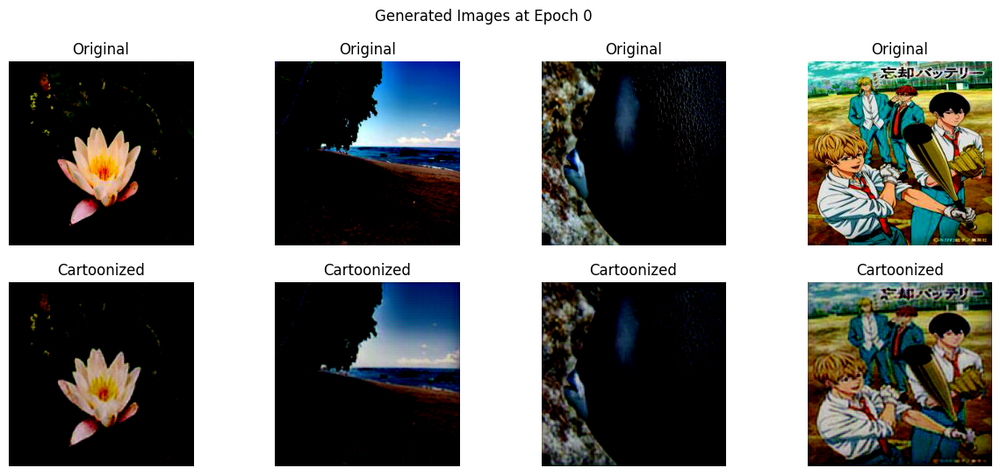

Shape of predictions: (100, 1000)
Sample predictions: [[1.3704726e-04 7.3021359e-04 1.5068072e-04 ... 2.7637475e-04
  1.3552983e-04 3.4933406e-04]
 [1.1338230e-04 1.3537634e-03 4.4250617e-05 ... 1.3018594e-03
  4.9826858e-04 2.3307008e-04]
 [1.7125698e-04 4.1062123e-04 3.0226764e-04 ... 1.8064443e-03
  4.0418364e-04 1.6995009e-04]
 [4.6220641e-05 1.4605482e-04 1.2871764e-04 ... 9.7375356e-05
  8.8626613e-05 2.6240860e-04]
 [1.0733580e-04 2.1723792e-04 2.9629681e-04 ... 1.7531791e-04
  4.6799687e-05 1.1454607e-04]]
Inception Score at epoch 0: 3.6969399452209473 ± 0.3817788362503052
Shape of real activations: (4, 1000)
Shape of generated activations: (4, 1000)
FID Score at epoch 0: 0.06580413258686207
[Shinkai Epoch 1/10] [Batch 0/25] [D loss: 0.3007219731807709] [G loss: 6.852604866027832]
[Shinkai Epoch 1/10] [Batch 1/25] [D loss: 0.3222346007823944] [G loss: 6.3821611404418945]
[Shinkai Epoch 1/10] [Batch 2/25] [D loss: 0.4930132329463959] [G loss: 6.386679649353027]
[Shinkai Epoch 1/

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9682615..0.87815183].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97400737..0.9190633].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.954567..0.9476135].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].
Clipping input data to the valid

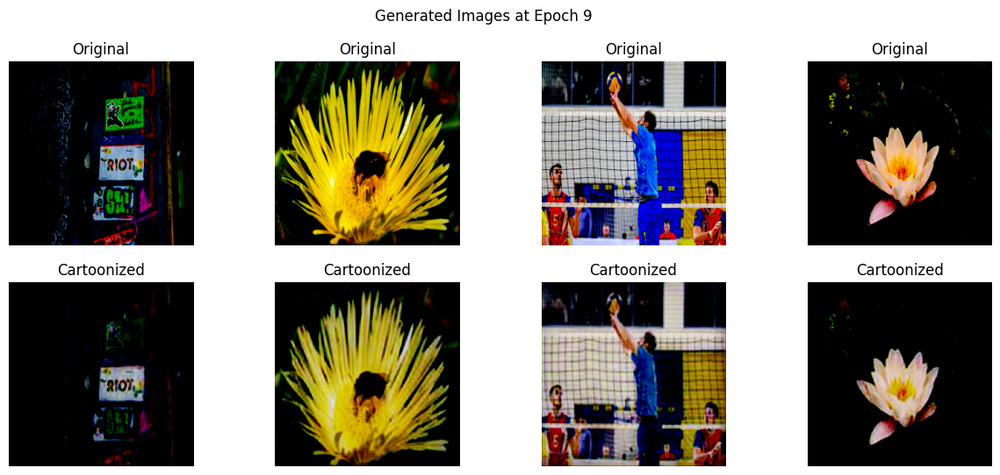

Shape of predictions: (100, 1000)
Sample predictions: [[1.65426580e-04 1.56876340e-03 1.13011571e-04 ... 1.91401326e-04
  7.86318968e-04 2.31769609e-05]
 [9.90792687e-05 1.55757516e-04 7.71766281e-05 ... 7.38312025e-04
  9.04519402e-05 7.98578985e-05]
 [9.31324976e-05 5.18836488e-04 1.88463164e-04 ... 1.85245334e-03
  2.01038958e-04 1.42467106e-04]
 [2.74969025e-05 1.34699381e-04 7.63764256e-05 ... 1.14845556e-04
  1.68237792e-04 1.26833271e-04]
 [4.03692356e-05 4.50635183e-04 1.42652687e-04 ... 5.68727737e-05
  7.45536934e-04 6.51242881e-05]]
Inception Score at epoch 9: 4.198635101318359 ± 0.30240505933761597
Shape of real activations: (4, 1000)
Shape of generated activations: (4, 1000)
FID Score at epoch 9: 0.470542905471054


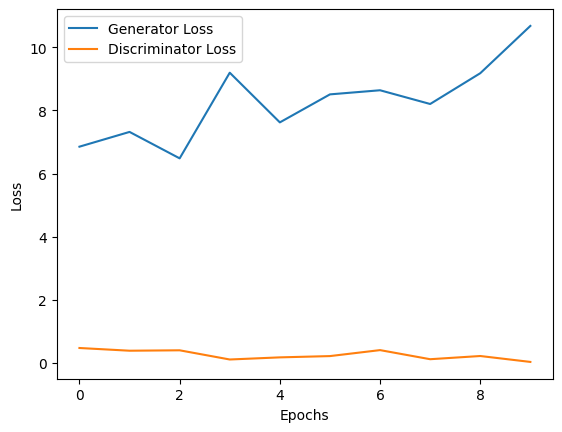

In [89]:
num_epochs = 10
lambda_content = 10.0

generator_losses = []
discriminator_losses = []

discriminator = Discriminator().to(device)
#generator = Generator().to(device)

#optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
#scheduler_G = torch.optim.lr_scheduler.StepLR(optimizer_G, step_size=10, gamma=0.1)

optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
scheduler_D = torch.optim.lr_scheduler.StepLR(optimizer_D, step_size=10, gamma=0.1)

# Ensure both dataloaders are the same length
min_len = min(len(real_train_dataloader), len(shinkai_dataloader))

for epoch in range(num_epochs):
    real_train_dataloader_iter = iter(real_train_dataloader)  # Reinitialize iterators at the start of each epoch
    shinkai_dataloader_iter = iter(shinkai_dataloader)       # Reinitialize iterators at the start of each epoch
    
    for i in range(min_len):
        try:
            real_imgs, _ = next(real_train_dataloader_iter)
        except StopIteration:
            real_train_dataloader_iter = iter(real_train_dataloader)
            real_imgs, _ = next(real_train_dataloader_iter)
            
        try:
            cartoon_imgs, _ = next(shinkai_dataloader_iter)
        except StopIteration:
            shinkai_dataloader_iter = iter(shinkai_dataloader)
            cartoon_imgs, _ = next(shinkai_dataloader_iter)
            
        real_imgs = real_imgs.to(device).float()
        cartoon_imgs = cartoon_imgs.to(device).float()

        # Create edge-smoothed cartoon images
        edge_smoothed_cartoon_imgs = torch.stack([process_cartoon_image(img) for img in cartoon_imgs])

        # Train Discriminator
        optimizer_D.zero_grad()
        fake_imgs = generator(real_imgs).float()
        
        # Create target tensors with the same size as the discriminator output
        valid = torch.ones_like(discriminator(real_imgs)).to(device)
        fake = torch.zeros_like(discriminator(fake_imgs.detach())).to(device)

        real_loss = adversarial_loss(discriminator(cartoon_imgs), valid)
        fake_loss_edge_smoothed = adversarial_loss(discriminator(edge_smoothed_cartoon_imgs), fake)
        fake_loss_generated = adversarial_loss(discriminator(fake_imgs.detach()), fake)
        d_loss = (real_loss + fake_loss_edge_smoothed + fake_loss_generated) / 3
        d_loss.backward()
        optimizer_D.step()

        # Train Generator
        optimizer_G.zero_grad()
        # Calculate content loss
        g_content_loss = content_loss(fake_imgs, real_imgs, vgg_feature_extractor)
        # Calculate adversarial loss
        g_adversarial_loss = adversarial_loss(discriminator(fake_imgs), valid)
        g_loss = g_adversarial_loss + lambda_content * g_content_loss
        g_loss.backward()
        optimizer_G.step()

        print(f"[Shinkai Epoch {epoch}/{num_epochs}] [Batch {i}/{min_len}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")

    scheduler_G.step()
    scheduler_D.step()

    # Record losses for plotting
    generator_losses.append(g_loss.item())
    discriminator_losses.append(d_loss.item())

    # Periodically evaluate model
    if epoch % 10 == 0 or epoch == num_epochs - 1:
        num_samples = 1000
        generated_samples = generate_samples(generator, real_train_dataloader, num_samples=num_samples)
        
        display_images(real_imgs.cpu().data, fake_imgs.cpu().data, epoch)
        
        is_mean, is_std = calculate_inception_score(generated_samples)
        print(f"Inception Score at epoch {epoch}: {is_mean} ± {is_std}")
        
        fid_score = calculate_fid(real_imgs, fake_imgs)
        print(f"FID Score at epoch {epoch}: {fid_score}")

        

    # Save the model checkpoint
    save_checkpoint({
        'epoch': epoch + 1,
        'generator_state_dict': generator.state_dict(),
        'optimizer_G_state_dict': optimizer_G.state_dict(),
        'discriminator_state_dict': discriminator.state_dict(),
        'optimizer_D_state_dict': optimizer_D.state_dict(),
    }, filename=f"adversarial_checkpoint_epoch_{epoch}.pth.tar")

# Plot the loss curves
plot_losses(generator_losses, discriminator_losses)


Continue Training

In [94]:
# Training loop
num_epochs = 50  # Total number of epochs to train
lambda_content = 10.0

generator_losses = []
discriminator_losses = []

discriminator = Discriminator().to(device)
#generator = Generator().to(device)

#optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
#scheduler_G = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer_G, T_max=num_epochs)  # Changed learning rate scheduler

optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
scheduler_D = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer_D, T_max=num_epochs)  # Changed learning rate scheduler

start_epoch = 0

# Load checkpoint if exists
checkpoint_path = "adversarial_checkpoint_epoch_9.pth.tar"
try:
    checkpoint = torch.load(checkpoint_path)
    generator.load_state_dict(checkpoint['generator_state_dict'])
    discriminator.load_state_dict(checkpoint['discriminator_state_dict'])
    optimizer_G.load_state_dict(checkpoint['optimizer_G_state_dict'])
    optimizer_D.load_state_dict(checkpoint['optimizer_D_state_dict'])
    start_epoch = checkpoint['epoch']
    print(f"Checkpoint loaded. Resuming from epoch {start_epoch}")
except FileNotFoundError:
    print("No checkpoint found. Starting from scratch.")

min_len = min(len(real_train_dataloader), len(shinkai_dataloader))

for epoch in range(start_epoch, num_epochs):
    real_train_dataloader_iter = iter(real_train_dataloader)
    shinkai_dataloader_iter = iter(shinkai_dataloader)
    
    for i in range(min_len):
        try:
            real_imgs, _ = next(real_train_dataloader_iter)
        except StopIteration:
            real_train_dataloader_iter = iter(real_train_dataloader)
            real_imgs, _ = next(real_train_dataloader_iter)
            
        try:
            cartoon_imgs, _ = next(shinkai_dataloader_iter)
        except StopIteration:
            shinkai_dataloader_iter = iter(shinkai_dataloader)
            cartoon_imgs, _ = next(shinkai_dataloader_iter)
            
        real_imgs = real_imgs.to(device).float()
        cartoon_imgs = cartoon_imgs.to(device).float()

        edge_smoothed_cartoon_imgs = torch.stack([process_cartoon_image(img) for img in cartoon_imgs])

        optimizer_D.zero_grad()
        fake_imgs = generator(real_imgs).float()
        
        valid = torch.ones_like(discriminator(real_imgs)).to(device)
        fake = torch.zeros_like(discriminator(fake_imgs.detach())).to(device)

        real_loss = adversarial_loss(discriminator(cartoon_imgs), valid)
        fake_loss_edge_smoothed = adversarial_loss(discriminator(edge_smoothed_cartoon_imgs), fake)
        fake_loss_generated = adversarial_loss(discriminator(fake_imgs.detach()), fake)
        d_loss = (real_loss + fake_loss_edge_smoothed + fake_loss_generated) / 3
        d_loss.backward()
        optimizer_D.step()

        optimizer_G.zero_grad()
        g_content_loss = content_loss(fake_imgs, real_imgs, vgg_feature_extractor)
        g_adversarial_loss = adversarial_loss(discriminator(fake_imgs), valid)
        g_loss = g_adversarial_loss + lambda_content * g_content_loss
        g_loss.backward()
        optimizer_G.step()

        print(f"[Shinkai Epoch {epoch}/{num_epochs}] [Batch {i}/{min_len}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")

    scheduler_G.step()
    scheduler_D.step()

    generator_losses.append(g_loss.item())
    discriminator_losses.append(d_loss.item())

    if epoch % 10 == 0 or epoch == num_epochs - 1:
        num_samples = 100  # Adjust based on your requirement and GPU memory
        generated_samples = generator(torch.randn(num_samples, 3, 256, 256, device=device)).detach()

        display_images(real_imgs.cpu().data, fake_imgs.cpu().data, epoch)

        is_mean, is_std = calculate_inception_score(generated_samples)
        print(f"Inception Score at epoch {epoch}: {is_mean} ± {is_std}")
        
        fid_score = calculate_fid(real_imgs, fake_imgs)
        print(f"FID Score at epoch {epoch}: {fid_score}")

    save_checkpoint({
        'epoch': epoch + 1,
        'generator_state_dict': generator.state_dict(),
        'optimizer_G_state_dict': optimizer_G.state_dict(),
        'discriminator_state_dict': discriminator.state_dict(),
        'optimizer_D_state_dict': optimizer_D.state_dict(),
    }, filename=f"adversarial_checkpoint_epoch_{epoch}.pth.tar")

plot_losses(generator_losses, discriminator_losses)

RuntimeError: CUDA error: out of memory
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


### Generate Cartoon Images from Test Dataset

Loaded model from epoch 327


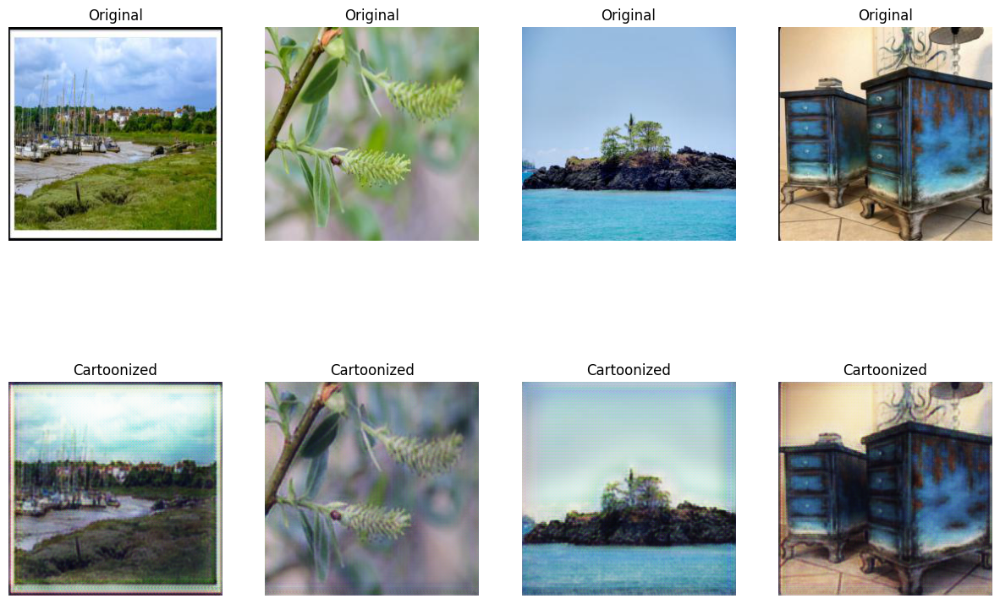

In [19]:
generator = Generator().to(device)

def load_checkpoint(filename, generator, optimizer_G):
    checkpoint = torch.load(filename)
    generator.load_state_dict(checkpoint['generator_state_dict'])
    optimizer_G.load_state_dict(checkpoint['optimizer_G_state_dict'])
    return checkpoint['epoch']

# Load the trained model
last_epoch = load_checkpoint('checkpoint_epoch_326.pth.tar', generator, optimizer_G)
print(f"Loaded model from epoch {last_epoch}")



# Function to cartoonize images
def cartoonize_images(generator, dataloader, device):
    generator.eval()
    cartoonized_images = []
    original_images = []
    
    with torch.no_grad():
        for imgs, _ in dataloader:
            imgs = imgs.to(device)
            cartoonized_imgs = generator(imgs)
            cartoonized_images.append(cartoonized_imgs.cpu())
            original_images.append(imgs.cpu())
    
    return torch.cat(original_images), torch.cat(cartoonized_images)

# Generate cartoonized images
original_images, cartoonized_images = cartoonize_images(generator, real_test_dataloader, device)

# Function to display original and cartoonized images
def display_comparison(original_images, cartoonized_images, num_images=4):
    plt.figure(figsize=(15, 10))
    for i in range(num_images):
        plt.subplot(2, num_images, i+1)
        plt.imshow(original_images[i].permute(1, 2, 0) * 0.5 + 0.5)
        plt.title('Original')
        plt.axis('off')
        
        plt.subplot(2, num_images, i+1+num_images)
        plt.imshow(cartoonized_images[i].permute(1, 2, 0) * 0.5 + 0.5)
        plt.title('Cartoonized')
        plt.axis('off')
    plt.show()

# Display the results
display_comparison(original_images, cartoonized_images)
